In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import pickle
import os
from collections import defaultdict

# Experimental Constants

In [2]:
NUM_REPEATS = 10
TRAIN_SIZE = 5000

In [3]:
synthetic_results_path = "../results/synthetic_data/"
method_types = {'models_causal_impute': {'meta_learner': ['t_learner', 's_learner', 'x_learner', 'dr_learner'], 
                                              'dml_learner': ['double_ml', 'causal_forest']}, 
                'models_causal_survival': ['causal_survival_forest'], 
                'models_causal_survival_meta': ['t_learner_survival', 's_learner_survival', 'matching_learner_survival']}

imputation_methods = ['Pseudo_obs', 'Margin', 'IPCW-T']
survival_models = ['RandomSurvivalForest', 'DeepSurv', 'DeepHit']

# File Loading and Structure of Results Pickles

In [4]:
# Loop through all method types
for method_category, subtypes in method_types.items():
    print(f"\n=== {method_category} ===")
    
    if method_category == 'models_causal_impute':
        for subgroup, method_list in subtypes.items():
            for method in method_list:
                method_path = os.path.join(synthetic_results_path, method_category, subgroup, method)
                if not os.path.exists(method_path):
                    print(f"Path not found: {method_path}")
                    continue

                for imp in imputation_methods:
                    file_name = f"{method}_{imp}_repeats_{NUM_REPEATS}_train_{TRAIN_SIZE}.pkl"
                    file_path = os.path.join(method_path, file_name)
                    if os.path.exists(file_path):
                        print(file_path)
                        if subgroup == 'meta_learner':
                            file_path_impute_meta_meta = file_path
                        else:
                            file_path_impute_meta_dml = file_path
                    else:
                        print(f"Missing: {file_path}")

    elif method_category == 'models_causal_survival':
        for method in subtypes:
            method_path = os.path.join(synthetic_results_path, method_category, method)
            if not os.path.exists(method_path):
                print(f"Path not found: {method_path}")
                continue

            file_name = f"{method}_repeats_{NUM_REPEATS}_train_{TRAIN_SIZE}.pkl"
            file_path = os.path.join(method_path, file_name)
            if os.path.exists(file_path):
                print(file_path)
                file_path_causal_survival = file_path
            else:
                print(f"Missing: {file_path}")

    elif method_category == 'models_causal_survival_meta':
        for method in subtypes:
            method_path = os.path.join(synthetic_results_path, method_category, method)
            if not os.path.exists(method_path):
                print(f"Path not found: {method_path}")
                continue

            for surv in survival_models:
                file_name = f"{method}_{surv}_repeats_{NUM_REPEATS}_train_{TRAIN_SIZE}.pkl"
                file_path = os.path.join(method_path, file_name)
                if os.path.exists(file_path):
                    print(file_path)
                    file_path_causal_survival_meta = file_path
                else:
                    print(f"Missing: {file_path}")


=== models_causal_impute ===
../results/synthetic_data/models_causal_impute/meta_learner/t_learner/t_learner_Pseudo_obs_repeats_10_train_5000.pkl
../results/synthetic_data/models_causal_impute/meta_learner/t_learner/t_learner_Margin_repeats_10_train_5000.pkl
../results/synthetic_data/models_causal_impute/meta_learner/t_learner/t_learner_IPCW-T_repeats_10_train_5000.pkl
../results/synthetic_data/models_causal_impute/meta_learner/s_learner/s_learner_Pseudo_obs_repeats_10_train_5000.pkl
../results/synthetic_data/models_causal_impute/meta_learner/s_learner/s_learner_Margin_repeats_10_train_5000.pkl
../results/synthetic_data/models_causal_impute/meta_learner/s_learner/s_learner_IPCW-T_repeats_10_train_5000.pkl
../results/synthetic_data/models_causal_impute/meta_learner/x_learner/x_learner_Pseudo_obs_repeats_10_train_5000.pkl
../results/synthetic_data/models_causal_impute/meta_learner/x_learner/x_learner_Margin_repeats_10_train_5000.pkl
../results/synthetic_data/models_causal_impute/meta_le

In [5]:
with open(file_path_impute_meta_meta, 'rb') as f:
        data = pickle.load(f)
        print(f"Loaded data from {file_path_impute_meta_meta}")

print(f"Category: models_causal_impute_meta")
print(f"Subgroup: meta_learner")
print()
print("Experiment Setups: (first layer keys):")
print(list(data.keys()))
print()
print("Simulation Scenarios: (second layer keys):")
print(list(data['e_X_U'].keys()))
print()
print("Base Regression Methods: (third layer keys):")
print(list(data['e_X_U']['scenario_1'].keys()))
print()
print("Experiment Repeats: (fourth layer keys):")
print(list(data['e_X_U']['scenario_1']['xgb'].keys()))
print()
print("(a) Specific Experiment Repeat: (fifth layer keys):")
print(list(data['e_X_U']['scenario_1']['xgb']['random_idx0'].keys()))
print("(b) Average of all Experiment Repeats: (fifth layer keys):")
print(list(data['e_X_U']['scenario_1']['xgb']['average'].keys()))

Loaded data from ../results/synthetic_data/models_causal_impute/meta_learner/dr_learner/dr_learner_IPCW-T_repeats_10_train_5000.pkl
Category: models_causal_impute_meta
Subgroup: meta_learner

Experiment Setups: (first layer keys):
['RCT_0_5', 'RCT_0_05', 'e_X', 'e_X_U', 'e_X_no_overlap', 'e_X_info_censor', 'e_X_U_info_censor', 'e_X_no_overlap_info_censor']

Simulation Scenarios: (second layer keys):
['scenario_1', 'scenario_2', 'scenario_5', 'scenario_8', 'scenario_9']

Base Regression Methods: (third layer keys):
['lasso', 'rf', 'xgb']

Experiment Repeats: (fourth layer keys):
['random_idx0', 'random_idx1', 'random_idx2', 'random_idx3', 'random_idx4', 'random_idx5', 'random_idx6', 'random_idx7', 'random_idx8', 'random_idx9', 'average']

(a) Specific Experiment Repeat: (fifth layer keys):
['cate_true', 'cate_pred', 'ate_true', 'ate_pred', 'cate_mse', 'ate_bias', 'base_model_eval']
(b) Average of all Experiment Repeats: (fifth layer keys):
['mean_cate_mse', 'std_cate_mse', 'mean_ate_pre

In [6]:
with open(file_path_impute_meta_dml, 'rb') as f:
        data = pickle.load(f)
        print(f"Loaded data from {file_path_impute_meta_dml}")

print(f"Category: models_causal_impute_meta")
print(f"Subgroup: double_machine_learning")
print()
print("Experiment Setups: (first layer keys):")
print(list(data.keys()))
print()
print("Simulation Scenarios: (second layer keys):")
print(list(data['e_X_U'].keys()))
print()
print("Experiment Repeats: (third layer keys):")
print(list(data['e_X_U']['scenario_1'].keys()))
print()
print("(a) Specific Experiment Repeat: (fourth layer keys):")
print(list(data['e_X_U']['scenario_1']['random_idx0'].keys()))
print("(b) Average of all Experiment Repeats: (fourth layer keys):")
print(list(data['e_X_U']['scenario_1']['average'].keys()))

Loaded data from ../results/synthetic_data/models_causal_impute/dml_learner/causal_forest/causal_forest_IPCW-T_repeats_10_train_5000.pkl
Category: models_causal_impute_meta
Subgroup: double_machine_learning

Experiment Setups: (first layer keys):
['RCT_0_5', 'RCT_0_05', 'e_X', 'e_X_U', 'e_X_no_overlap', 'e_X_info_censor', 'e_X_U_info_censor', 'e_X_no_overlap_info_censor']

Simulation Scenarios: (second layer keys):
['scenario_1', 'scenario_2', 'scenario_5', 'scenario_8', 'scenario_9']

Experiment Repeats: (third layer keys):
['random_idx0', 'random_idx1', 'random_idx2', 'random_idx3', 'random_idx4', 'random_idx5', 'random_idx6', 'random_idx7', 'random_idx8', 'random_idx9', 'average']

(a) Specific Experiment Repeat: (fourth layer keys):
['cate_true', 'cate_pred', 'ate_true', 'ate_pred', 'cate_mse', 'ate_bias']
(b) Average of all Experiment Repeats: (fourth layer keys):
['mean_cate_mse', 'std_cate_mse', 'mean_ate_pred', 'std_ate_pred', 'mean_ate_true', 'std_ate_true', 'mean_ate_bias', '

In [7]:
with open(file_path_causal_survival, 'rb') as f:
        data = pickle.load(f)
        print(f"Loaded data from {file_path_causal_survival}")

print(f"Category: causal_survival")
print()
print("Experiment Setups: (first layer keys):")
print(list(data.keys()))
print()
print("Simulation Scenarios: (second layer keys):")
print(list(data['e_X_U'].keys()))
print()
print("Experiment Repeats: (third layer keys):")
print(list(data['e_X_U']['scenario_1'].keys()))
print()
print("(a) Specific Experiment Repeat: (fourth layer keys):")
print(list(data['e_X_U']['scenario_1']['random_idx0'].keys()))
print("(b) Average of all Experiment Repeats: (fourth layer keys):")
print(list(data['e_X_U']['scenario_1']['average'].keys()))

Loaded data from ../results/synthetic_data/models_causal_survival/causal_survival_forest/causal_survival_forest_repeats_10_train_5000.pkl
Category: causal_survival

Experiment Setups: (first layer keys):
['RCT_0_5', 'RCT_0_05', 'e_X', 'e_X_U', 'e_X_no_overlap', 'e_X_info_censor', 'e_X_U_info_censor', 'e_X_no_overlap_info_censor']

Simulation Scenarios: (second layer keys):
['scenario_1', 'scenario_2', 'scenario_5', 'scenario_8', 'scenario_9']

Experiment Repeats: (third layer keys):
['random_idx0', 'random_idx1', 'random_idx2', 'random_idx3', 'random_idx4', 'random_idx5', 'random_idx6', 'random_idx7', 'random_idx8', 'random_idx9', 'average']

(a) Specific Experiment Repeat: (fourth layer keys):
['cate_true', 'cate_pred', 'ate_true', 'ate_pred', 'cate_mse', 'ate_bias']
(b) Average of all Experiment Repeats: (fourth layer keys):
['mean_cate_mse', 'std_cate_mse', 'mean_ate_pred', 'std_ate_pred', 'mean_ate_true', 'std_ate_true', 'mean_ate_bias', 'std_ate_bias', 'runtime']


In [8]:
with open(file_path_causal_survival_meta, 'rb') as f:
        data = pickle.load(f)
        print(f"Loaded data from {file_path_causal_survival_meta}")

print(f"Category: causal_survival")
print()
print("Experiment Setups: (first layer keys):")
print(list(data.keys()))
print()
print("Simulation Scenarios: (second layer keys):")
print(list(data['e_X_U'].keys()))
print()
print("Experiment Repeats: (third layer keys):")
print(list(data['e_X_U']['scenario_1'].keys()))
print()
print("(a) Specific Experiment Repeat: (fourth layer keys):")
print(list(data['e_X_U']['scenario_1']['random_idx0'].keys()))
print("(b) Average of all Experiment Repeats: (fourth layer keys):")
print(list(data['e_X_U']['scenario_1']['average'].keys()))

Loaded data from ../results/synthetic_data/models_causal_survival_meta/matching_learner_survival/matching_learner_survival_DeepHit_repeats_10_train_5000.pkl
Category: causal_survival

Experiment Setups: (first layer keys):
['RCT_0_5', 'RCT_0_05', 'e_X', 'e_X_U', 'e_X_no_overlap', 'e_X_info_censor', 'e_X_U_info_censor', 'e_X_no_overlap_info_censor']

Simulation Scenarios: (second layer keys):
['scenario_1', 'scenario_2', 'scenario_5', 'scenario_8', 'scenario_9']

Experiment Repeats: (third layer keys):
['random_idx0', 'random_idx1', 'random_idx2', 'random_idx3', 'random_idx4', 'random_idx5', 'random_idx6', 'random_idx7', 'random_idx8', 'random_idx9', 'average']

(a) Specific Experiment Repeat: (fourth layer keys):
['cate_true', 'cate_pred', 'ate_true', 'ate_pred', 'cate_mse', 'ate_bias', 'base_model_eval']
(b) Average of all Experiment Repeats: (fourth layer keys):
['mean_cate_mse', 'std_cate_mse', 'mean_ate_pred', 'std_ate_pred', 'mean_ate_true', 'std_ate_true', 'mean_ate_bias', 'std_a

# Adjusted True ATE

In [9]:
TRUE_ATE = {('RCT_0_5', 'scenario_1'): 0.124969, ('RCT_0_5', 'scenario_2'): 0.163441, ('RCT_0_5', 'scenario_5'): 0.74996,
            ('RCT_0_5', 'scenario_8'): 0.7537, ('RCT_0_5', 'scenario_9'): 0.723925,
            ('RCT_0_05', 'scenario_1'): 0.124969, ('RCT_0_05', 'scenario_2'): 0.163441, ('RCT_0_05', 'scenario_5'): 0.74996,
            ('RCT_0_05', 'scenario_8'): 0.7537, ('RCT_0_05', 'scenario_9'): 0.723925,
            ('e_X', 'scenario_1'): 0.124969, ('e_X', 'scenario_2'): 0.163441, ('e_X', 'scenario_5'): 0.74996,
            ('e_X', 'scenario_8'): 0.7537, ('e_X', 'scenario_9'): 0.723925,
            ('e_X_U', 'scenario_1'): 0.131728, ('e_X_U', 'scenario_2'): 0.003744, ('e_X_U', 'scenario_5'): 0.74036,
            ('e_X_U', 'scenario_8'): 0.74032, ('e_X_U', 'scenario_9'): 0.830668,
            ('e_X_no_overlap', 'scenario_1'): 0.124969, ('e_X_no_overlap', 'scenario_2'): 0.163441, ('e_X_no_overlap', 'scenario_5'): 0.74996,
            ('e_X_no_overlap', 'scenario_8'): 0.7537, ('e_X_no_overlap', 'scenario_9'): 0.723925,
            ('e_X_info_censor', 'scenario_1'): 0.124969, ('e_X_info_censor', 'scenario_2'): 0.163441, ('e_X_info_censor', 'scenario_5'): 0.74996,
            ('e_X_info_censor', 'scenario_8'): 0.7537, ('e_X_info_censor', 'scenario_9'): 0.723925,
            ('e_X_U_info_censor', 'scenario_1'): 0.131728, ('e_X_U_info_censor', 'scenario_2'): 0.003744, ('e_X_U_info_censor', 'scenario_5'): 0.74036,
            ('e_X_U_info_censor', 'scenario_8'): 0.74032, ('e_X_U_info_censor', 'scenario_9'): 0.830668,
            ('e_X_no_overlap_info_censor', 'scenario_1'): 0.124969, ('e_X_no_overlap_info_censor', 'scenario_2'): 0.163441, 
            ('e_X_no_overlap_info_censor', 'scenario_5'): 0.74996, ('e_X_no_overlap_info_censor', 'scenario_8'): 0.7537, 
            ('e_X_no_overlap_info_censor', 'scenario_9'): 0.723925}

# Aggregate results

In [10]:
import os
import pickle
import pandas as pd
from sklearn.metrics import mean_squared_error

def aggregate_results(
    synthetic_results_path: str,
    train_size: int = 5000,
    num_repeats: int = 10,
    true_ate = None,
) -> pd.DataFrame:
    # Constants
    method_types = {
        'models_causal_impute': {
            'meta_learner': ['t_learner', 's_learner', 'x_learner', 'dr_learner'],
            'dml_learner': ['double_ml', 'causal_forest']
        },
        'models_causal_survival': ['causal_survival_forest'],
        'models_causal_survival_meta': ['t_learner_survival', 's_learner_survival', 'matching_learner_survival']
    }
    imputation_methods = ['Pseudo_obs', 'Margin', 'IPCW-T']
    survival_models = ['RandomSurvivalForest', 'DeepSurv', 'DeepHit']
    experiment_setups = ['RCT_0_5', 'RCT_0_05', 'e_X', 'e_X_U', 'e_X_no_overlap', 'e_X_info_censor', 'e_X_U_info_censor', 'e_X_no_overlap_info_censor']
    scenarios = ['scenario_1', 'scenario_2', 'scenario_5', 'scenario_8', 'scenario_9']

    # Results container
    results_table = []

    def append_result_row(abstract_key, method_key, method_category, imputation_method, base_model, base_survival, setup, scenario, 
                          mse_test, mse_valid, mse, ate_bias, ate_bias_interval):
        results_table.append({
            "abstract_method": abstract_key,
            "method": method_key,
            "category": method_category,
            "imputation_method": imputation_method,
            "base_model": base_model,
            "base_survival": base_survival,
            "experiment_setup": setup,
            "scenario": scenario,
            "mean_cate_mse_test": mse_test,
            "mean_cate_mse_valid": mse_valid,
            "cate_mse": mse,
            "ate_bias": ate_bias,
            "ate_bias_interval": ate_bias_interval
        })

    def mse_calculation(exp_data, subset="all"):
        cate_true_each_repeat = ([exp_data[rnd_repeat]['cate_true'] 
                                  for rnd_repeat in exp_data 
                                  if rnd_repeat != "average"])
        cate_pred_each_repeat = ([exp_data[rnd_repeat]['cate_pred'] 
                                  for rnd_repeat in exp_data 
                                  if rnd_repeat != "average"])
        
        len_valid = len(cate_true_each_repeat[0]) // 2

        if subset == "all":
            mse = np.array([mean_squared_error(cate_true_each_repeat[i], cate_pred_each_repeat[i]) 
                            for i in range(len(cate_true_each_repeat))])
        elif subset == "valid":
            mse = np.array([mean_squared_error(cate_true_each_repeat[i][:len_valid], cate_pred_each_repeat[i][:len_valid]) 
                            for i in range(len(cate_true_each_repeat))])
        elif subset == "test":
            mse = np.array([mean_squared_error(cate_true_each_repeat[i][len_valid:], cate_pred_each_repeat[i][len_valid:]) 
                            for i in range(len(cate_true_each_repeat))])
        return mse
    

    def ate_bias_calculation(exp_data, true_ate):
        if true_ate is None:
            ate_bias_each_repeat = np.array([exp_data[rnd_repeat]['ate_bias'] 
                                             for rnd_repeat in exp_data 
                                             if rnd_repeat != "average"])
        else:
            ate_bias_each_repeat = np.array([exp_data[rnd_repeat]['ate_pred'] 
                                             for rnd_repeat in exp_data 
                                             if rnd_repeat != "average"]) - true_ate
        
        return ate_bias_each_repeat
    

    def ate_interval_calculation(exp_data, true_ate):
        ate_interval_each_repeat = []
        for i, rnd_repeat in enumerate(exp_data):
            true_ate_current = exp_data[rnd_repeat]['ate_true'] if true_ate is None else true_ate
            if "ate_interval" in exp_data[rnd_repeat]:
                ate_interval_ = exp_data[rnd_repeat]['ate_interval']
                ate_interval_each_repeat.append((ate_interval_[0]- true_ate_current,
                                                 ate_interval_[1] - true_ate_current))
            else:
                ate_interval_each_repeat.append((true_ate_current, true_ate_current))
        
        return ate_interval_each_repeat
    

    for method_category, subtypes in method_types.items():
        if method_category == 'models_causal_impute':
            for subgroup, method_list in subtypes.items():
                for method in method_list:
                    for imp in imputation_methods:
                        file_name = f"{method}_{imp}_repeats_{num_repeats}_train_{train_size}.pkl"
                        file_path = os.path.join(synthetic_results_path, method_category, subgroup, method, file_name)
                        if not os.path.exists(file_path):
                            continue
                        with open(file_path, "rb") as f:
                            data = pickle.load(f)
                        for exp in experiment_setups:
                            if exp not in data:
                                continue
                            for scen in scenarios:
                                if scen not in data[exp]:
                                    continue
                                if subgroup == "meta_learner":
                                    for base_model in data[exp][scen]:
                                        # avg_data = data[exp][scen][base_model].get("average", {})
                                        # mse = avg_data.get("mean_cate_mse", None)
                                        mse_test  = mse_calculation(data[exp][scen][base_model], "test") 
                                        mse_valid = mse_calculation(data[exp][scen][base_model], "valid")  
                                        ate_bias = ate_bias_calculation(data[exp][scen][base_model], true_ate.get((exp, scen), None))  
                                        ate_bias_interval = ate_interval_calculation(data[exp][scen][base_model], true_ate.get((exp, scen), None))                                       
                                        if mse_test is not None:
                                            abstract_key = f"{method}"
                                            key = f"{method}+{imp}+{base_model}"
                                            category = f"{method_category}/{subgroup}"
                                            append_result_row(abstract_key, key, category, imp, base_model, None, exp, scen, 
                                                              np.mean(mse_test), np.mean(mse_valid), mse_test, ate_bias, ate_bias_interval)
                                else:
                                    # avg_data = data[exp][scen].get("average", {})
                                    # mse = avg_data.get("mean_cate_mse", None)
                                    mse_test  = mse_calculation(data[exp][scen], "test")
                                    mse_valid = mse_calculation(data[exp][scen], "valid")     
                                    ate_bias = ate_bias_calculation(data[exp][scen], true_ate.get((exp, scen), None))
                                    ate_bias_interval = ate_interval_calculation(data[exp][scen], true_ate.get((exp, scen), None))
                                    if mse_test is not None:
                                        abstract_key = f"{method}"
                                        key = f"{method}+{imp}"
                                        category = f"{method_category}/{subgroup}"
                                        append_result_row(abstract_key, key, category, imp, None, None, exp, scen, 
                                                          np.mean(mse_test), np.mean(mse_valid), mse_test, ate_bias, ate_bias_interval)

        elif method_category == 'models_causal_survival':
            for method in subtypes:
                file_name = f"{method}_repeats_{num_repeats}_train_{train_size}.pkl"
                file_path = os.path.join(synthetic_results_path, method_category, method, file_name)
                if not os.path.exists(file_path):
                    continue
                with open(file_path, "rb") as f:
                    data = pickle.load(f)
                for exp in experiment_setups:
                    if exp not in data:
                        continue
                    for scen in scenarios:
                        if scen not in data[exp]:
                            continue
                        # avg_data = data[exp][scen].get("average", {})
                        # mse = avg_data.get("mean_cate_mse", None)
                        mse_test  = mse_calculation(data[exp][scen], "test")  
                        mse_valid = mse_calculation(data[exp][scen], "valid")   
                        ate_bias = ate_bias_calculation(data[exp][scen], true_ate.get((exp, scen), None))
                        ate_bias_interval = ate_interval_calculation(data[exp][scen], true_ate.get((exp, scen), None))
                        if mse_test is not None:
                            append_result_row(method, method, method_category, None, None, None, exp, scen, 
                                              np.mean(mse_test), np.mean(mse_valid), mse_test, ate_bias, ate_bias_interval)

        elif method_category == 'models_causal_survival_meta':
            for method in subtypes:
                for surv_model in survival_models:
                    file_name = f"{method}_{surv_model}_repeats_{num_repeats}_train_{train_size}.pkl"
                    file_path = os.path.join(synthetic_results_path, method_category, method, file_name)
                    if not os.path.exists(file_path):
                        continue
                    with open(file_path, "rb") as f:
                        data = pickle.load(f)
                    for exp in experiment_setups:
                        if exp not in data:
                            continue
                        for scen in scenarios:
                            if scen not in data[exp]:
                                continue
                            # avg_data = data[exp][scen].get("average", {})
                            # mse = avg_data.get("mean_cate_mse", None)
                            mse_test = mse_calculation(data[exp][scen], "test")
                            mse_valid = mse_calculation(data[exp][scen], "valid")
                            ate_bias = ate_bias_calculation(data[exp][scen], true_ate.get((exp, scen), None))
                            ate_bias_interval = ate_interval_calculation(data[exp][scen], true_ate.get((exp, scen), None))
                            if mse_test is not None:
                                abstract_key = f"{method}"
                                key = f"{method}+{surv_model}"
                                append_result_row(abstract_key, key, method_category, None, None, surv_model, exp, scen, 
                                                  np.mean(mse_test), np.mean(mse_valid), mse_test, ate_bias, ate_bias_interval)

    # Build DataFrame and compute Borda ranking
    df_results = pd.DataFrame(results_table)
    # pivot_df = df_results.pivot_table(index="method", columns=["experiment_setup", "scenario"], values="cate_mse")
    # rank_df = pivot_df.rank(axis=0, method='min', ascending=True)
    # avg_rank = rank_df.mean(axis=1).sort_values()
    # borda_table = avg_rank.reset_index()
    # borda_table.columns = ["method", "avg_borda_rank"]
    return df_results


In [11]:
df_results = aggregate_results("../results/synthetic_data/", true_ate=TRUE_ATE)
df_results

,abstract_method,method,category,imputation_method,base_model,base_survival,experiment_setup,scenario,mean_cate_mse_test,mean_cate_mse_valid,cate_mse,ate_bias,ate_bias_interval
0,t_learner,t_learner+Pseudo_obs+lasso,models_causal_impute/meta_learner,Pseudo_obs,lasso,None,RCT_0_5,scenario_1,0.657257,0.717183,"[0.6559901566687304, 0.6537570414505686, 0.573...","[0.013065487445628465, -0.019293162879808423, ...","[(-0.03223611451972694, 0.05836708941098387), ..."
1,t_learner,t_learner+Pseudo_obs+rf,models_causal_impute/meta_learner,Pseudo_obs,rf,None,RCT_0_5,scenario_1,0.753953,0.801101,"[0.7005446791642277, 1.082735632199705, 0.5999...","[0.01867486533156898, 0.006468374027049251, -0...","[(-0.7347229105541396, 0.7720726412172773), (-..."
2,t_learner,t_learner+Pseudo_obs+xgb,models_causal_impute/meta_learner,Pseudo_obs,xgb,None,RCT_0_5,scenario_1,0.890280,0.940067,"[0.902497982780427, 1.3275545104863122, 0.6824...","[0.0069163648521006205, 0.001056226513855174, ...","[(-1.3461870596091137, 1.3600197893133146), (-..."
3,t_learner,t_learner+Pseudo_obs+lasso,models_causal_impute/meta_learner,Pseudo_obs,lasso,None,RCT_0_5,scenario_2,12.325402,15.075595,"[13.016466418058869, 13.826364209172526, 13.61...","[-0.1475972694435485, -0.1455294653353179, -0....","[(-0.2048309552334559, -0.09036358365364111), ..."
4,t_learner,t_learner+Pseudo_obs+rf,models_causal_impute/meta_learner,Pseudo_obs,rf,None,RCT_0_5,scenario_2,12.279018,15.018028,"[13.028259482247167, 13.703392922258574, 13.43...","[-0.14611829186793013, -0.1368808129462158, -0...","[(-0.8906550243278224, 0.5984184405919621), (-..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...
2075,matching_learner_survival,matching_learner_survival+DeepHit,models_causal_survival_meta,None,None,DeepHit,e_X_no_overlap_info_censor,scenario_1,0.666341,0.724704,"[0.6658298806712947, 0.6655505671814317, 0.578...","[-0.09987760938727488, -0.09100868012728333, -...","[(0.124969, 0.124969), (0.124969, 0.124969), (..."
2076,matching_learner_survival,matching_learner_survival+DeepHit,models_causal_survival_meta,None,None,DeepHit,e_X_no_overlap_info_censor,scenario_2,12.287394,15.034338,"[12.992986972270437, 13.791923638871475, 13.57...","[-0.1796856931209338, -0.16544247213281132, -0...","[(0.163441, 0.163441), (0.163441, 0.163441), (..."
2077,matching_learner_survival,matching_learner_survival+DeepHit,models_causal_survival_meta,None,None,DeepHit,e_X_no_overlap_info_censor,scenario_5,15.072638,15.065869,"[14.537492176897075, 14.266097311472818, 14.98...","[0.1693616196736336, -0.5336963649317291, -0.5...","[(0.74996, 0.74996), (0.74996, 0.74996), (0.74..."
2078,matching_learner_survival,matching_learner_survival+DeepHit,models_causal_survival_meta,None,None,DeepHit,e_X_no_overlap_info_censor,scenario_8,16.694804,16.688427,"[16.857684357995556, 16.220872939193253, 16.46...","[-0.4338395825500319, -0.44671532083453774, -0...","[(0.7537, 0.7537), (0.7537, 0.7537), (0.7537, ..."


# Best of Each Experimental Setting for the Abstract Method

In [12]:
# Group by experiment_setup, scenario, and abstract_method, then get the idx of the row with the lowest mean_cate_mse_valid
best_idx = (
    df_results.groupby(["experiment_setup", "scenario", "abstract_method"])["mean_cate_mse_valid"]
    .idxmin()
)

# Use those indices to select rows
best_model_for_each_exp_setting = df_results.loc[best_idx].reset_index(drop=True)
best_model_for_each_exp_setting

,abstract_method,method,category,imputation_method,base_model,base_survival,experiment_setup,scenario,mean_cate_mse_test,mean_cate_mse_valid,cate_mse,ate_bias,ate_bias_interval
0,causal_forest,causal_forest+IPCW-T,models_causal_impute/dml_learner,IPCW-T,None,None,RCT_0_05,scenario_1,0.661835,0.721401,"[0.665474952278418, 0.6572829365706981, 0.5852...","[-0.023345143768928683, -0.03328158551926416, ...","[(0.124969, 0.124969), (0.124969, 0.124969), (..."
1,causal_survival_forest,causal_survival_forest,models_causal_survival,None,None,None,RCT_0_05,scenario_1,0.651543,0.713840,"[0.6484955456689937, 0.6453750743417315, 0.572...","[0.0679748627452163, 0.020856351811939733, -0....","[(0.124969, 0.124969), (0.124969, 0.124969), (..."
2,double_ml,double_ml+Margin,models_causal_impute/dml_learner,Margin,None,None,RCT_0_05,scenario_1,0.652313,0.713084,"[0.6456522832633695, 0.6450183271859052, 0.576...","[-0.0007833096943658246, -0.01663744801700799,...","[(0.124969, 0.124969), (0.124969, 0.124969), (..."
3,dr_learner,dr_learner+Margin+lasso,models_causal_impute/meta_learner,Margin,lasso,None,RCT_0_05,scenario_1,0.658479,0.718500,"[0.6565585471688291, 0.65495732104204, 0.57366...","[0.033954656604994776, -0.03290821142025892, -...","[(0.124969, 0.124969), (0.124969, 0.124969), (..."
4,matching_learner_survival,matching_learner_survival+DeepSurv,models_causal_survival_meta,None,None,DeepSurv,RCT_0_05,scenario_1,0.662491,0.722450,"[0.6569519835297986, 0.6535105635987517, 0.568...","[0.07656999715768759, -0.025343318827601727, -...","[(0.124969, 0.124969), (0.124969, 0.124969), (..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...
395,s_learner,s_learner+Margin+xgb,models_causal_impute/meta_learner,Margin,xgb,None,e_X_no_overlap_info_censor,scenario_9,40.668868,43.879574,"[39.559425669200444, 39.53689236772545, 34.396...","[-0.623749528746307, -0.7787095473349095, -0.5...","[(-1.2667043134013052, 0.019205255908691043), ..."
396,s_learner_survival,s_learner_survival+RandomSurvivalForest,models_causal_survival_meta,None,None,RandomSurvivalForest,e_X_no_overlap_info_censor,scenario_9,40.117943,43.271466,"[39.25431148796389, 38.95925903856127, 34.0867...","[-0.5886753940092659, -0.5874202697961646, -0....","[(0.723925, 0.723925), (0.723925, 0.723925), (..."
397,t_learner,t_learner+Margin+rf,models_causal_impute/meta_learner,Margin,rf,None,e_X_no_overlap_info_censor,scenario_9,40.852357,44.027845,"[39.54768251601611, 39.67069883120137, 35.0432...","[-0.6206592914039426, -0.7556425857225115, -0....","[(-1.531142512754436, 0.2898239299465505), (-1..."
398,t_learner_survival,t_learner_survival+RandomSurvivalForest,models_causal_survival_meta,None,None,RandomSurvivalForest,e_X_no_overlap_info_censor,scenario_9,40.022512,43.196619,"[39.06900453851094, 39.374978263170554, 33.768...","[-0.5410946144193789, -0.3646227896407456, -0....","[(0.723925, 0.723925), (0.723925, 0.723925), (..."


# Plotting Helper Functions

In [13]:
# Updated mapping for prettier and consistent experiment names
pretty_experiment_names = {
    "RCT_0_5": "RCT: ✓ (50%), Ignorability: ✓, Positivity: ✓, Ignorable Censoring: ✓",
    "RCT_0_05": "RCT: ✓ (5%), Ignorability: ✓, Positivity: ✓, Ignorable Censoring: ✓",
    "e_X": "RCT: ✗, Ignorability: ✓, Positivity: ✓, Ignorable Censoring: ✓",
    "e_X_U": "RCT: ✗, Ignorability: ✗, Positivity: ✓, Ignorable Censoring: ✓",
    "e_X_no_overlap": "RCT: ✗, Ignorability: ✓, Positivity: ✗, Ignorable Censoring: ✓",
    "e_X_info_censor": "RCT: ✗, Ignorability: ✓, Positivity: ✓, Ignorable Censoring: ✗",
    "e_X_U_info_censor": "RCT: ✗, Ignorability: ✗, Positivity: ✓, Ignorable Censoring: ✗",
    "e_X_no_overlap_info_censor": "RCT: ✗, Ignorability: ✓, Positivity: ✗, Ignorable Censoring: ✗"
}

# Mapping for pretty method names
pretty_method_names_plotting = {
    "t_learner": "T-Learner",
    "s_learner": "S-Learner",
    "x_learner": "X-Learner",
    "dr_learner": "DR-Learner",
    "double_ml": "Double-ML",
    "causal_forest": "Causal\nForest",
    "causal_survival_forest": "Causal\nSurvival\nForest",
    "t_learner_survival": "T-Learner\nSurvival",
    "s_learner_survival": "S-Learner\nSurvival",
    "matching_learner_survival": "Matching\nSurvival"
}

pretty_method_names = {
    "t_learner": "T-Learner",
    "s_learner": "S-Learner",
    "x_learner": "X-Learner",
    "dr_learner": "DR-Learner",
    "double_ml": "Double-ML",
    "causal_forest": "Causal Forest",
    "causal_survival_forest": "Causal Survival Forest",
    "t_learner_survival": "T-Learner Survival",
    "s_learner_survival": "S-Learner Survival",
    "matching_learner_survival": "Matching Survival"
}

In [14]:
def pretty_results_table(df_plot):
    # Create a new DataFrame to store the pretty results
    pretty_df = pd.DataFrame()

    # Iterate through each row in the original DataFrame
    pretty_df['experiment_id'] = df_plot['experiment_setup']
    pretty_df['experiment'] = df_plot['experiment_setup'].map(pretty_experiment_names)
    pretty_df['method'] = df_plot['abstract_method'].map(pretty_method_names)
    pretty_df['best_imputation'] = df_plot['imputation_method'].fillna(" ")
    pretty_df['best_base_model'] = df_plot['base_model'].fillna(" ")
    pretty_df['best_base_survival'] = df_plot['base_survival'].fillna(" ")
    pretty_df['cate_mse'] = [f"{np.mean(method_run_):.3f} ± {np.std(method_run_):.3f}" for method_run_ in df_plot['cate_mse']]
    pretty_df['ate_bias'] = [f"{np.mean(method_run_):.3f} ± {np.std(method_run_):.3f}" for method_run_ in df_plot['ate_bias']]

    return pretty_df

In [55]:
import seaborn as sns
import matplotlib.pyplot as plt

def plot_aggregated_experiment_results(scenario_key, df_plot_raw, skip_experiments_list=None, 
                                       metric="mean_cate_mse_test", y_lim=None, title_include_scenario=False):
    if scenario_key not in df_plot_raw['scenario'].values:
        print(f"Scenario '{scenario_key}' not found in aggregated results.")
        return

    # Color settings
    category_palette_alpha = {
        "models_causal_impute/meta_learner": (31/255, 119/255, 180/255, 0.6),   # Blue, light
        "models_causal_impute/dml_learner": (8/255, 77/255, 117/255, 0.8),      # Blue, dark
        "models_causal_survival": (44/255, 160/255, 44/255, 0.8),               # Green
        "models_causal_survival_meta": (214/255, 39/255, 40/255, 0.8)           # Red
    }

    category_bg = {
        "models_causal_impute/meta_learner": (208/255, 230/255, 252/255),      # Very light blue
        "models_causal_impute/dml_learner": (198/255, 220/255, 242/255),       # Very light blue
        "models_causal_survival": (220/255, 245/255, 220/255),                 # Very light green
        "models_causal_survival_meta": (255/255, 225/255, 225/255)             # Very light red
    }

    df_plot = df_plot_raw[df_plot_raw['scenario']==scenario_key].copy()
    df_plot["color"] = df_plot["category"].map(category_palette_alpha)
    df_plot["bg_color"] = df_plot["category"].map(category_bg)

    if y_lim is None:
        y_min = np.concatenate(df_plot[metric].values).min()
        y_max = np.concatenate(df_plot[metric].values).max()
        y_margin = (y_max - y_min) * 0.1
        y_lim = (y_min - y_margin, y_max + y_margin)

    # sns.set(style="whitegrid", font_scale=1.2)
    plt.rcParams["figure.dpi"] = 300

    for exp_key, exp_title in pretty_experiment_names.items():
        if skip_experiments_list and exp_key in skip_experiments_list:
            continue

        exp_df = df_plot[df_plot["experiment_setup"] == exp_key]
        # methods = exp_df["abstract_method"].map(pretty_method_names_plotting).unique()
        methods = pretty_method_names_plotting.values()
        # true_ate = exp_df["ate_true"]
        exp_title = f"({scenario_key}) {exp_title}" if title_include_scenario else exp_title

        plt.figure(figsize=(11, 3))
        ax = plt.gca()

        # --- Y limits ---
        if y_lim is False:
            y_min = np.concatenate(exp_df[metric].values).min()
            y_max = np.concatenate(exp_df[metric].values).max()
            y_margin = (y_max - y_min) * 0.1
            ax.set_ylim((y_min - y_margin, y_max + y_margin))
        else:
            ax.set_ylim(y_lim)

        ax.set_xlim(-0.5, len(methods) - 0.5)

        # --- X ticks ---
        ax.set_xticks(range(len(methods)))
        ax.set_xticklabels(methods, rotation=-30, fontsize=14)

        # --- Gridlines ---
        ax.xaxis.grid(True, linestyle="--", linewidth=0.5)
        ax.yaxis.grid(True, linestyle="--", linewidth=0.5)

        # --- Background spans for contiguous color blocks (no white lines) ---
        # --- Perfect seamless background spans for contiguous blocks ---
        epsilon = 1  # small overlap to prevent white gaps
        bg_colors = [exp_df[exp_df["abstract_method"].map(pretty_method_names_plotting) == method]["bg_color"].iloc[0] for method in methods]

        start = 0
        for i in range(1, len(bg_colors)):
            if bg_colors[i] != bg_colors[i - 1]:
                # slightly overlap spans
                ax.axvspan(start - 0.5, i - 0.5 + epsilon, facecolor=bg_colors[i - 1], zorder=0, edgecolor='black', linewidth=0)
                start = i
        # draw the last background block
        ax.axvspan(start - 0.5, len(bg_colors) - 0.5 + epsilon, facecolor=bg_colors[-1], zorder=0, edgecolor='black', linewidth=0)

        # --- Boxplots ---
        for i, method in enumerate(methods):
            method_data = exp_df[exp_df["abstract_method"].map(pretty_method_names_plotting) == method]
            y_vals = method_data[metric].values[0]
            color = method_data["color"].iloc[0] if not method_data.empty else (0.7, 0.7, 0.7, 0.7)

            sns.boxplot(
                x=[i] * len(y_vals),
                y=y_vals,
                ax=ax,
                color=color,
                width=0.3,  # thinner
                showcaps=True,
                boxprops=dict(facecolor=color, edgecolor='black', linewidth=1.0),
                whiskerprops=dict(color='black', linewidth=0.8),
                medianprops=dict(color='black', linewidth=1.2),
                showfliers=False
            )

            ax.scatter(
                [i] * len(y_vals), y_vals,
                color=color,
                # edgecolor='black',
                s=10,
                zorder=1,
                alpha=0.7
            )

            if metric == "ate_bias":
                # Midpoints and asymmetric errors
                ate_bias_interval = method_data["ate_bias_interval"].values[0]
                lower_bounds, upper_bounds = zip(*ate_bias_interval)
                lower_bounds = np.array(lower_bounds)
                upper_bounds = np.array(upper_bounds)
                midpoints = (np.array(lower_bounds) + np.array(upper_bounds)) / 2
                yerr_lower = midpoints - np.array(lower_bounds)
                yerr_upper = np.array(upper_bounds) - midpoints

                ax.errorbar(
                    x=[i] * len(ate_bias_interval),
                    y=midpoints,
                    yerr=[yerr_lower, yerr_upper],
                    # fmt='o',
                    color=color,
                    capsize=1,
                    elinewidth=0.5,
                    alpha=0.3
                )

        # --- Reference line for true ATE ---
        # if metric in {"ate_pred", "ate_true"}:
        #     ax.axhline(y=true_ate.mean(), color='black', linestyle='--', linewidth=1.5, label="True ATE")
        #     ax.legend(loc="upper right", fontsize=12)
        
        if metric == "ate_bias":
            ax.axhline(y=0, color='black', linestyle='--', linewidth=1.5, label="No Bias", zorder=0, alpha=0.4)
            # ax.legend(loc="upper right", fontsize=12)

        # --- Axis labels & title ---
        # ax.set_title(exp_title, pad=15)
        y_label_map = {
            "cate_mse": "CATE MSE",
            "ate_true": "True ATE",
            "ate_pred": "Pred ATE",
            "ate_bias": "ATE Bias"
        }
        ax.set_ylabel(y_label_map.get(metric, metric), fontsize=14, fontweight='bold')
        ax.set_xlabel("")

        # plt.yticks(fontsize=12)

        plt.tight_layout()

        plt.savefig(f"figure_results/{metric}/{scenario_key}_{exp_key}_{metric}.pdf", bbox_inches='tight')

        plt.show()


# Figure Generation Parameters

(Metric, Experiments to Exclude, Y-Axis Constant)

In [16]:
skip_experiments_list = [] #['RCT_0_5', 'RCT_0_05']
# metric = "ate_bias"  # Choose from ['cate_mse', 'ate_true', 'ate_pred', 'ate_bias']
# y_lim = None # Set to False to use individual y-limits for each plot or None for global limits

Y_LIM = {"cate_mse": {'scenario_1': (0.55, 0.9),
                     'scenario_2': (10, 18.5),
                     'scenario_5': (13.75, 16.5),
                     'scenario_8': (15.75, 18.5),
                    #  'scenario_8': (15.75, 20.75),
                     'scenario_9': (35, 56)},
         "ate_bias": {'scenario_1': None,
                      'scenario_2': (-0.5, 0.42),
                      'scenario_5': (-1.7, 0.5),
                      'scenario_8': (-2.1, 1.1),
                      'scenario_9': (-1.75, 0.05)}}

# CATE

In [17]:
skip_experiments_list = [] #['RCT_0_5', 'RCT_0_05']
metric = "cate_mse"  # Choose from ['cate_mse', 'ate_true', 'ate_pred', 'ate_bias']

## Scenario 1

Scenario: scenario_1


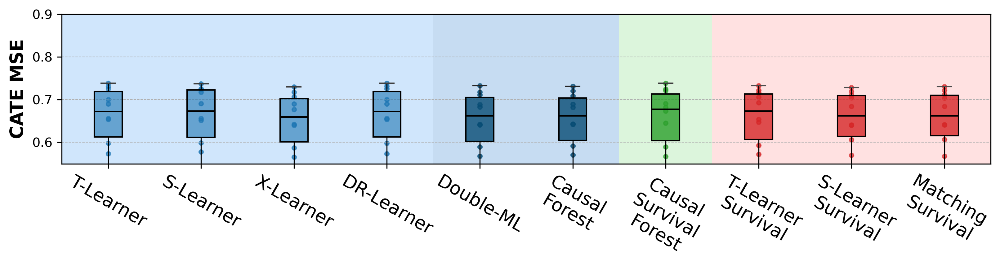

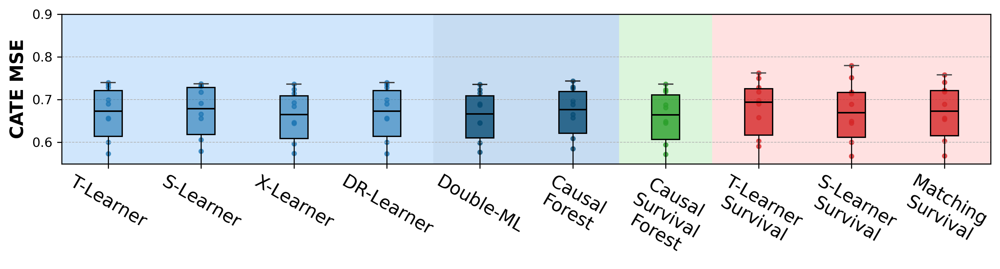

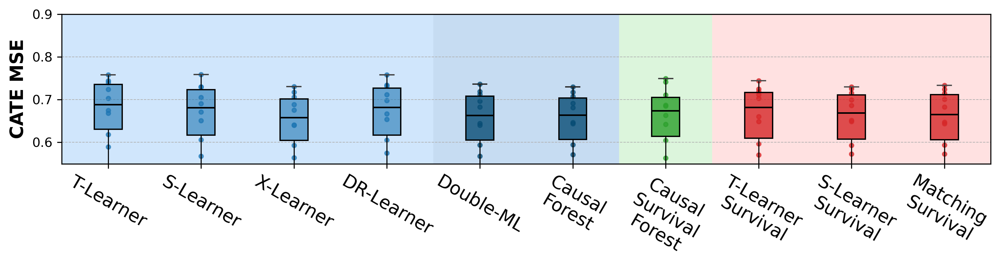

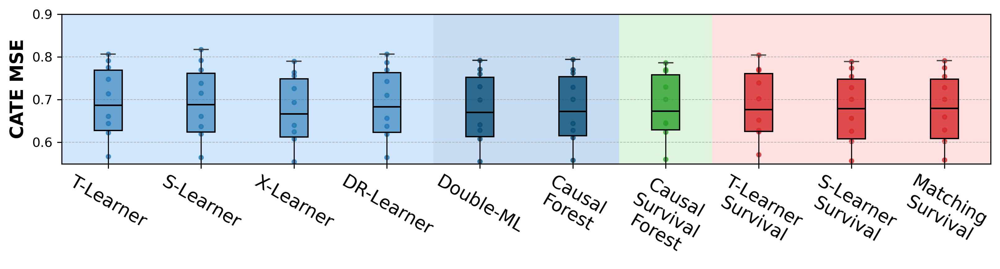

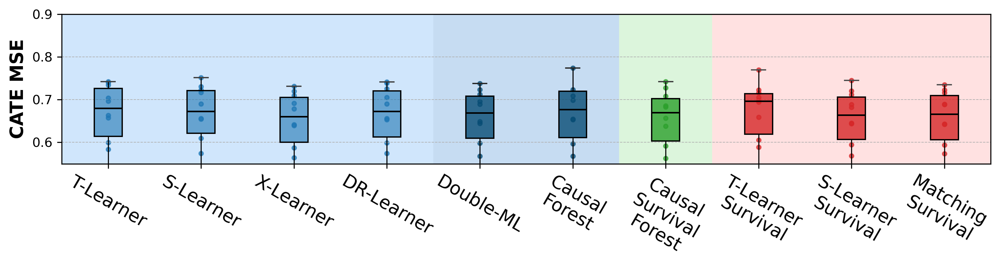

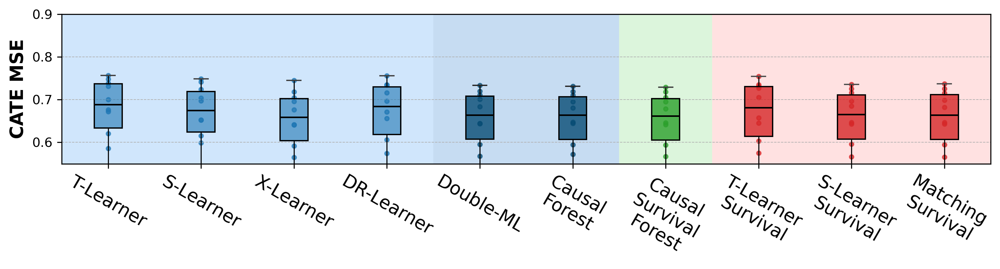

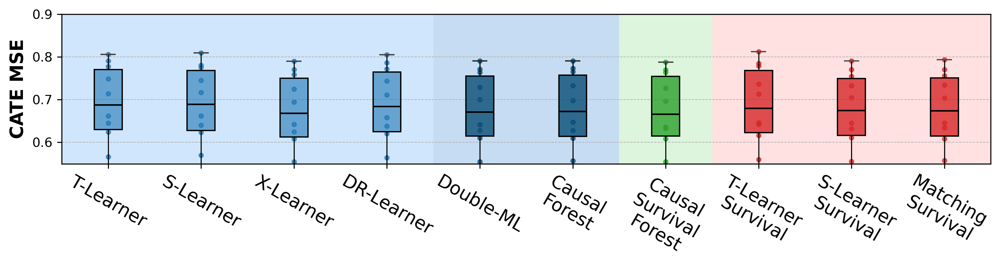

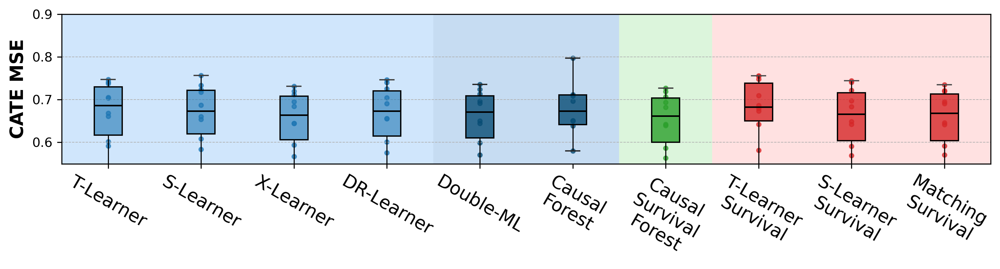

In [18]:
# Set the scenario key
scenario_key = "scenario_1"

# skip_experiments_list = ["RCT_0_5", "RCT_0_05"]
# metric = "cate_mse"  # Choose from ['cate_mse', 'ate_true', 'ate_pred', 'ate_bias']
# y_lim = None # Set to False to use individual y-limits for each plot or None for global limits
print(f"Scenario: {scenario_key}")

y_lim = Y_LIM.get(metric, {}).get(scenario_key, None)

plot_aggregated_experiment_results(scenario_key, best_model_for_each_exp_setting, skip_experiments_list, metric=metric, y_lim=y_lim, title_include_scenario=False)

In [19]:
# Set the scenario key
# scenario_key = "scenario_1"
# skip_experiments_list = ["RCT_0_5", "RCT_0_05"]

best_model_for_each_exp_setting

print(f"Scenario: {scenario_key}")
pretty_results_table(best_model_for_each_exp_setting[best_model_for_each_exp_setting['scenario']==scenario_key])

Scenario: scenario_1


,experiment_id,experiment,method,best_imputation,best_base_model,best_base_survival,cate_mse,ate_bias
0,RCT_0_05,"RCT: ✓ (5%), Ignorability: ✓, Positivity: ✓, I...",Causal Forest,IPCW-T,,,0.662 ± 0.068,-0.023 ± 0.034
1,RCT_0_05,"RCT: ✓ (5%), Ignorability: ✓, Positivity: ✓, I...",Causal Survival Forest,,,,0.652 ± 0.070,0.018 ± 0.052
2,RCT_0_05,"RCT: ✓ (5%), Ignorability: ✓, Positivity: ✓, I...",Double-ML,Margin,,,0.652 ± 0.070,-0.012 ± 0.036
3,RCT_0_05,"RCT: ✓ (5%), Ignorability: ✓, Positivity: ✓, I...",DR-Learner,Margin,lasso,,0.658 ± 0.073,-0.009 ± 0.041
4,RCT_0_05,"RCT: ✓ (5%), Ignorability: ✓, Positivity: ✓, I...",Matching Survival,,,DeepSurv,0.662 ± 0.075,-0.017 ± 0.066
...,...,...,...,...,...,...,...,...
355,e_X_no_overlap_info_censor,"RCT: ✗, Ignorability: ✓, Positivity: ✗, Ignora...",S-Learner,Margin,xgb,,0.666 ± 0.068,-0.041 ± 0.018
356,e_X_no_overlap_info_censor,"RCT: ✗, Ignorability: ✓, Positivity: ✗, Ignora...",S-Learner Survival,,,DeepSurv,0.654 ± 0.076,-0.051 ± 0.018
357,e_X_no_overlap_info_censor,"RCT: ✗, Ignorability: ✓, Positivity: ✗, Ignora...",T-Learner,IPCW-T,lasso,,0.668 ± 0.071,0.110 ± 0.012
358,e_X_no_overlap_info_censor,"RCT: ✗, Ignorability: ✓, Positivity: ✗, Ignora...",T-Learner Survival,,,DeepSurv,0.675 ± 0.073,-0.085 ± 0.037


## Scenario 2

Scenario: scenario_2


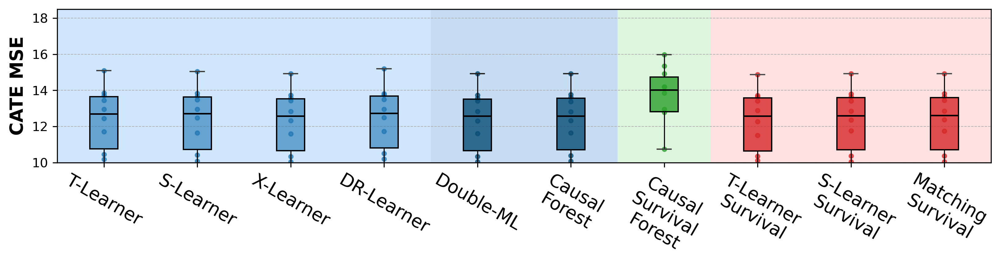

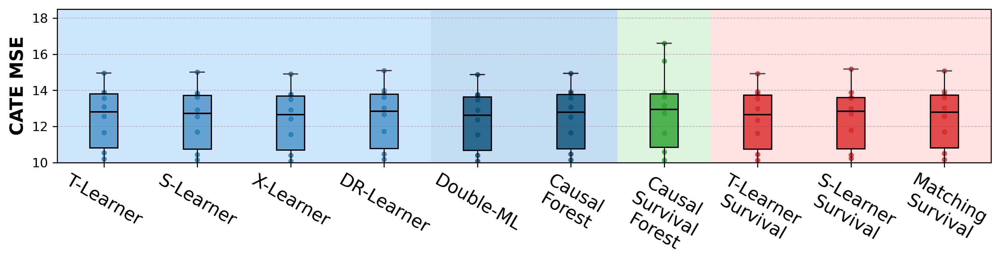

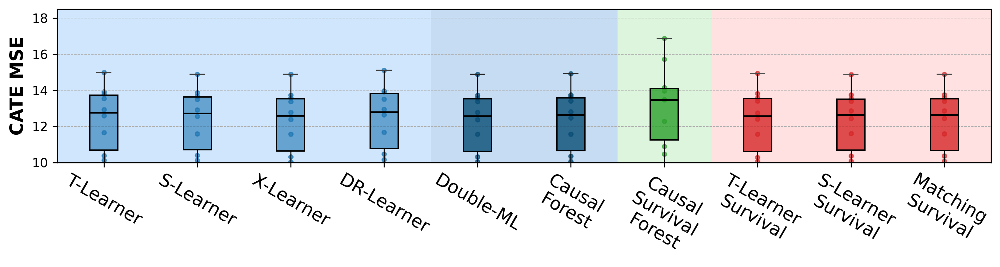

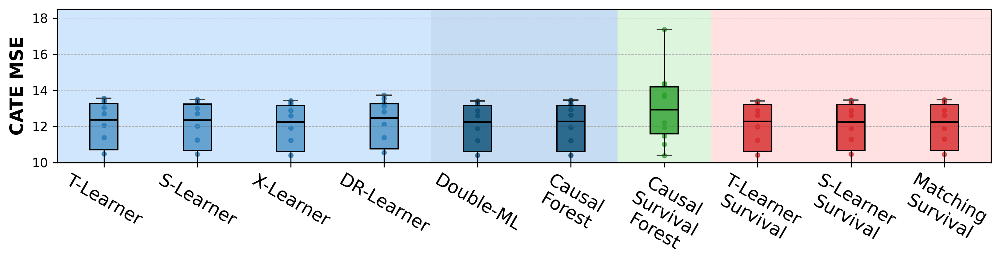

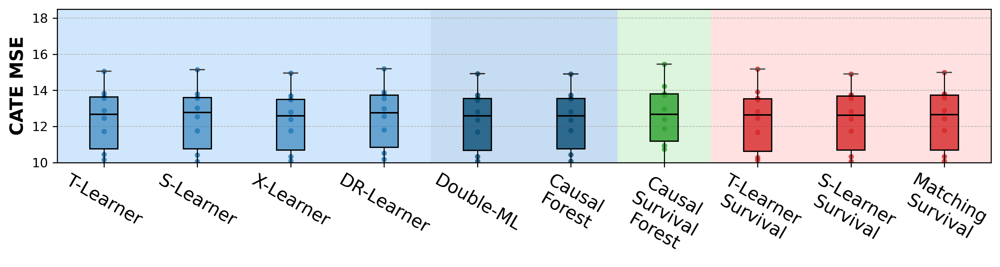

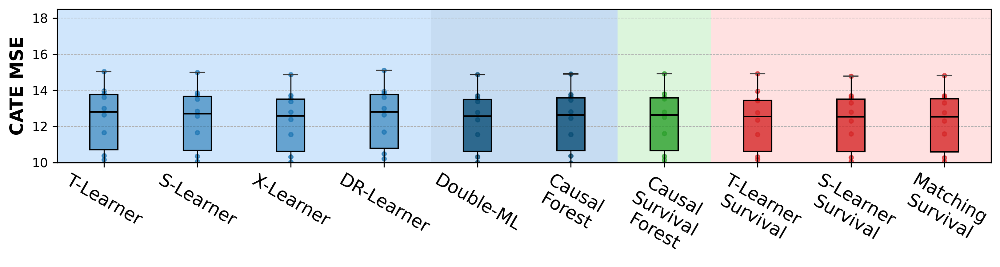

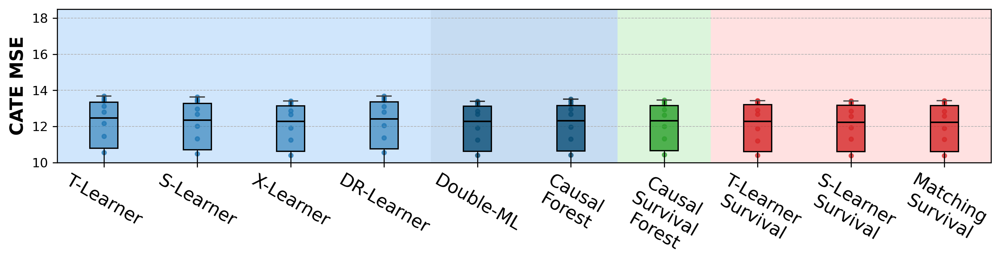

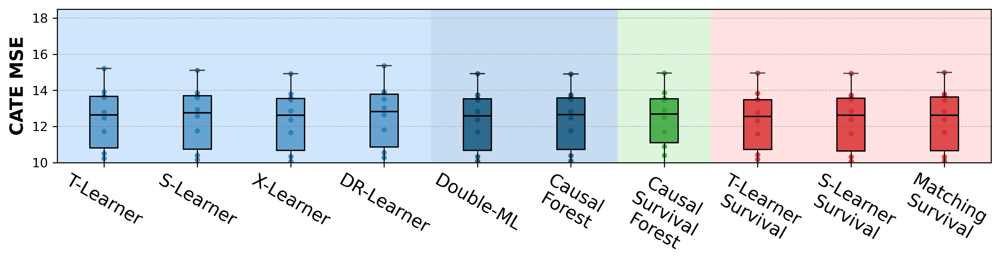

In [20]:
# Set the scenario key
scenario_key = "scenario_2"

# skip_experiments_list = ["RCT_0_5", "RCT_0_05"]
# metric = "cate_mse"  # Choose from ['cate_mse', 'ate_true', 'ate_pred', 'ate_bias']
# y_lim = None # Set to False to use individual y-limits for each plot or None for global limits
print(f"Scenario: {scenario_key}")

# y_lim = (10, 18.5)
y_lim = Y_LIM.get(metric, {}).get(scenario_key, None)

plot_aggregated_experiment_results(scenario_key, best_model_for_each_exp_setting, skip_experiments_list, metric=metric, y_lim=y_lim, title_include_scenario=False)

In [21]:
# Set the scenario key
# scenario_key = "scenario_2"
# skip_experiments_list = ["RCT_0_5", "RCT_0_05"]

best_model_for_each_exp_setting

print(f"Scenario: {scenario_key}")
pretty_results_table(best_model_for_each_exp_setting[best_model_for_each_exp_setting['scenario']==scenario_key])

Scenario: scenario_2


,experiment_id,experiment,method,best_imputation,best_base_model,best_base_survival,cate_mse,ate_bias
10,RCT_0_05,"RCT: ✓ (5%), Ignorability: ✓, Positivity: ✓, I...",Causal Forest,Margin,,,12.275 ± 1.906,-0.161 ± 0.037
11,RCT_0_05,"RCT: ✓ (5%), Ignorability: ✓, Positivity: ✓, I...",Causal Survival Forest,,,,12.662 ± 2.352,-0.038 ± 0.475
12,RCT_0_05,"RCT: ✓ (5%), Ignorability: ✓, Positivity: ✓, I...",Double-ML,Pseudo_obs,,,12.162 ± 1.886,-0.157 ± 0.045
13,RCT_0_05,"RCT: ✓ (5%), Ignorability: ✓, Positivity: ✓, I...",DR-Learner,IPCW-T,lasso,,12.327 ± 1.919,-0.163 ± 0.033
14,RCT_0_05,"RCT: ✓ (5%), Ignorability: ✓, Positivity: ✓, I...",Matching Survival,,,RandomSurvivalForest,12.300 ± 1.908,-0.167 ± 0.029
...,...,...,...,...,...,...,...,...
365,e_X_no_overlap_info_censor,"RCT: ✗, Ignorability: ✓, Positivity: ✗, Ignora...",S-Learner,IPCW-T,xgb,,12.274 ± 1.918,-0.178 ± 0.034
366,e_X_no_overlap_info_censor,"RCT: ✗, Ignorability: ✓, Positivity: ✗, Ignora...",S-Learner Survival,,,DeepSurv,12.160 ± 1.883,-0.168 ± 0.033
367,e_X_no_overlap_info_censor,"RCT: ✗, Ignorability: ✓, Positivity: ✗, Ignora...",T-Learner,IPCW-T,rf,,12.287 ± 1.903,-0.202 ± 0.037
368,e_X_no_overlap_info_censor,"RCT: ✗, Ignorability: ✓, Positivity: ✗, Ignora...",T-Learner Survival,,,DeepSurv,12.161 ± 1.868,-0.161 ± 0.058


## Scenario 5

Scenario: scenario_5


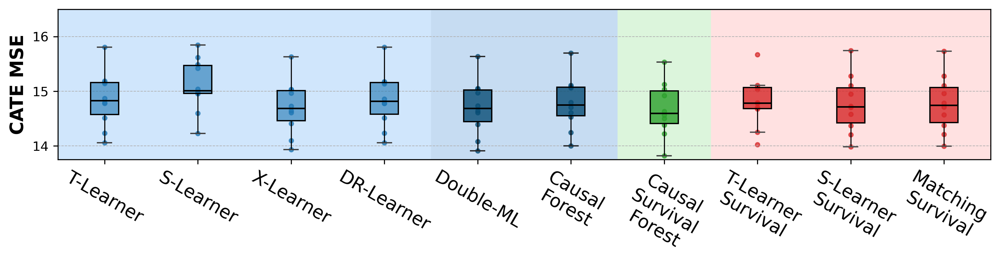

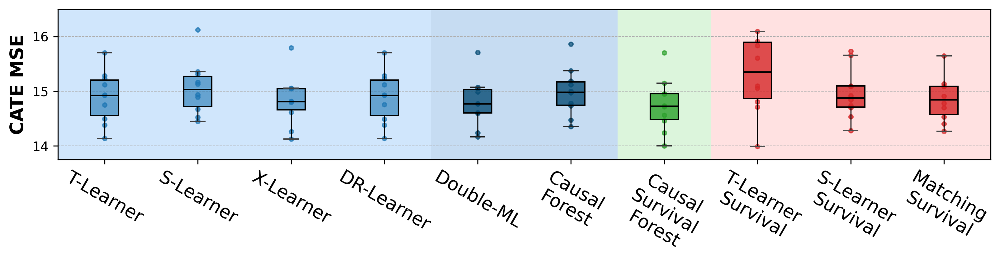

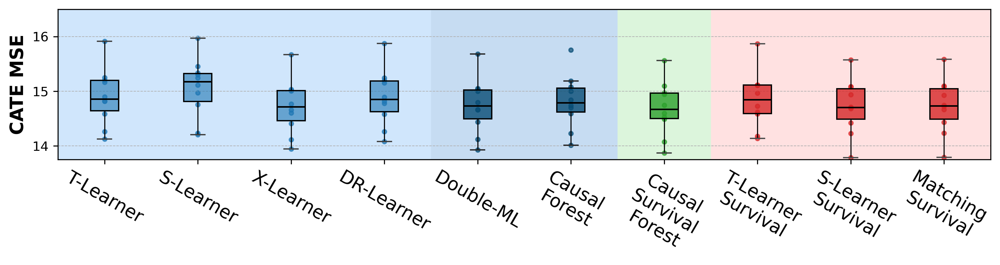

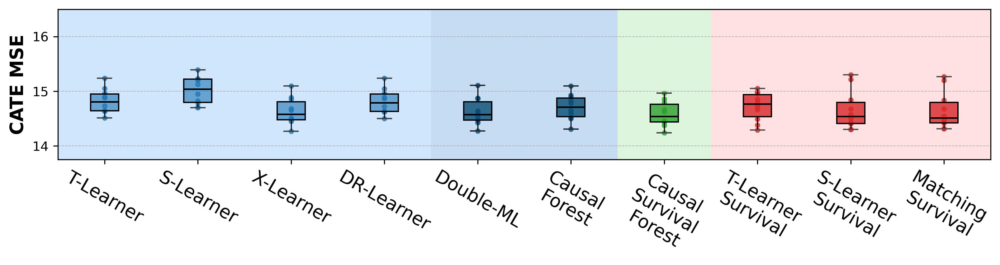

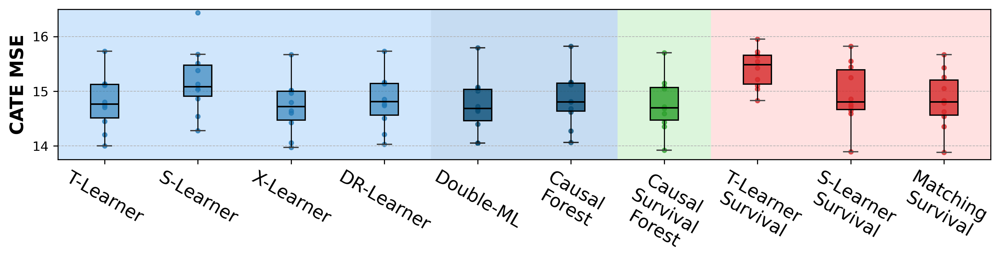

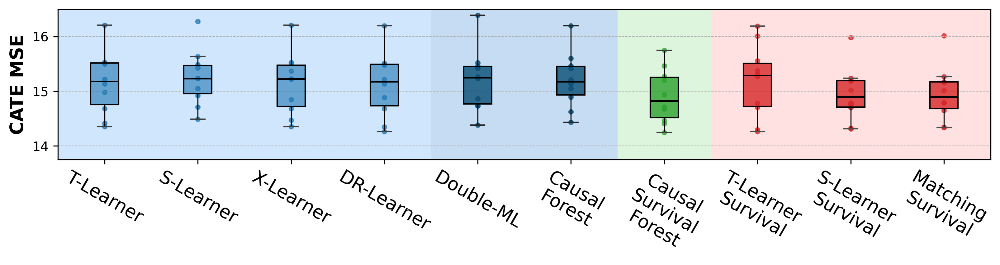

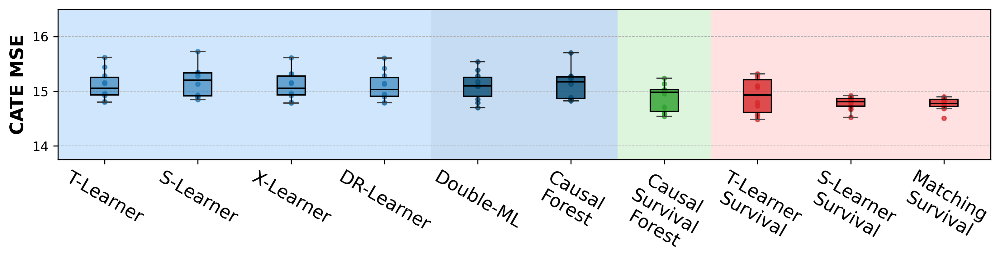

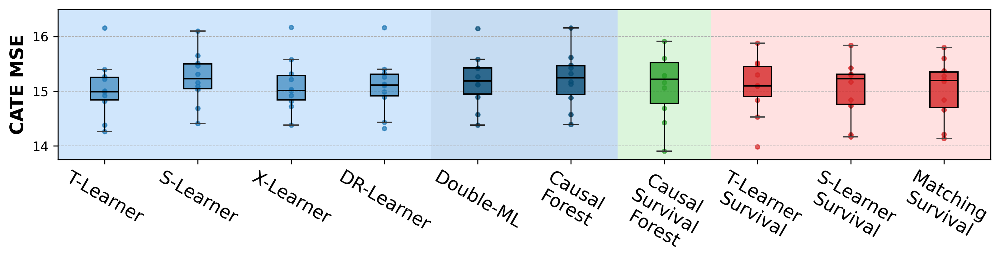

In [22]:
# Set the scenario key
scenario_key = "scenario_5"

# skip_experiments_list = ["RCT_0_5", "RCT_0_05"]
# metric = "cate_mse"  # Choose from ['cate_mse', 'ate_true', 'ate_pred', 'ate_bias']
# y_lim = None # Set to False to use individual y-limits for each plot or None for global limits
print(f"Scenario: {scenario_key}")

y_lim = Y_LIM.get(metric, {}).get(scenario_key, None)
# y_lim = (13.75, 16.25)

plot_aggregated_experiment_results(scenario_key, best_model_for_each_exp_setting, skip_experiments_list, metric=metric, y_lim=y_lim, title_include_scenario=False)

In [23]:
# Set the scenario key
# scenario_key = "scenario_5"
# skip_experiments_list = ["RCT_0_5", "RCT_0_05"]

best_model_for_each_exp_setting

print(f"Scenario: {scenario_key}")
pretty_results_table(best_model_for_each_exp_setting[best_model_for_each_exp_setting['scenario']==scenario_key])

Scenario: scenario_5


,experiment_id,experiment,method,best_imputation,best_base_model,best_base_survival,cate_mse,ate_bias
20,RCT_0_05,"RCT: ✓ (5%), Ignorability: ✓, Positivity: ✓, I...",Causal Forest,IPCW-T,,,14.983 ± 0.420,-0.310 ± 0.144
21,RCT_0_05,"RCT: ✓ (5%), Ignorability: ✓, Positivity: ✓, I...",Causal Survival Forest,,,,14.743 ± 0.457,-0.143 ± 0.229
22,RCT_0_05,"RCT: ✓ (5%), Ignorability: ✓, Positivity: ✓, I...",Double-ML,IPCW-T,,,14.795 ± 0.423,-0.323 ± 0.144
23,RCT_0_05,"RCT: ✓ (5%), Ignorability: ✓, Positivity: ✓, I...",DR-Learner,IPCW-T,lasso,,14.893 ± 0.446,-0.315 ± 0.163
24,RCT_0_05,"RCT: ✓ (5%), Ignorability: ✓, Positivity: ✓, I...",Matching Survival,,,DeepSurv,14.852 ± 0.389,-0.080 ± 0.202
...,...,...,...,...,...,...,...,...
375,e_X_no_overlap_info_censor,"RCT: ✗, Ignorability: ✓, Positivity: ✗, Ignora...",S-Learner,Margin,rf,,15.239 ± 0.459,-0.663 ± 0.086
376,e_X_no_overlap_info_censor,"RCT: ✗, Ignorability: ✓, Positivity: ✗, Ignora...",S-Learner Survival,,,DeepSurv,15.027 ± 0.511,0.007 ± 0.396
377,e_X_no_overlap_info_censor,"RCT: ✗, Ignorability: ✓, Positivity: ✗, Ignora...",T-Learner,Pseudo_obs,lasso,,15.039 ± 0.508,-0.504 ± 0.093
378,e_X_no_overlap_info_censor,"RCT: ✗, Ignorability: ✓, Positivity: ✗, Ignora...",T-Learner Survival,,,DeepHit,15.082 ± 0.512,-0.162 ± 0.210


## Scenario 8

Scenario: scenario_8


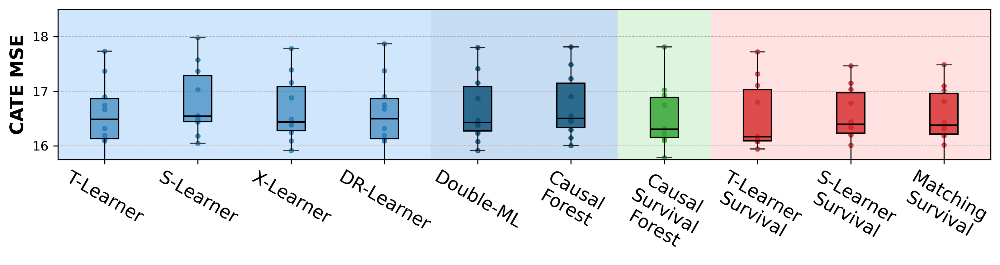

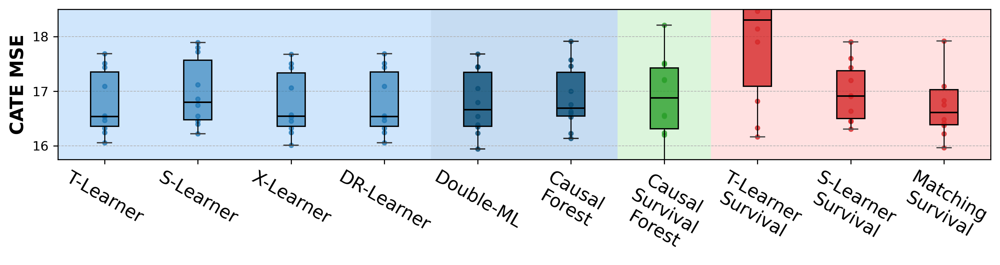

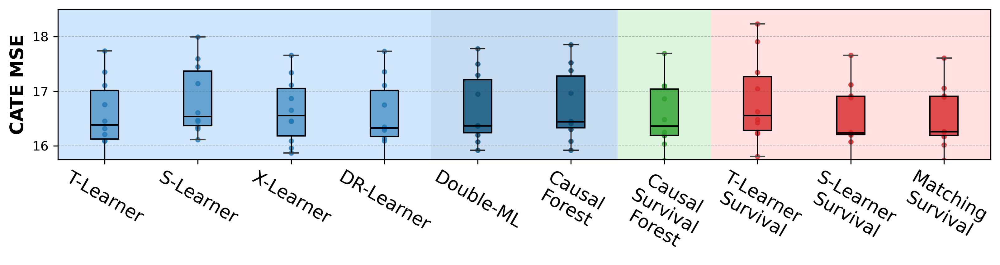

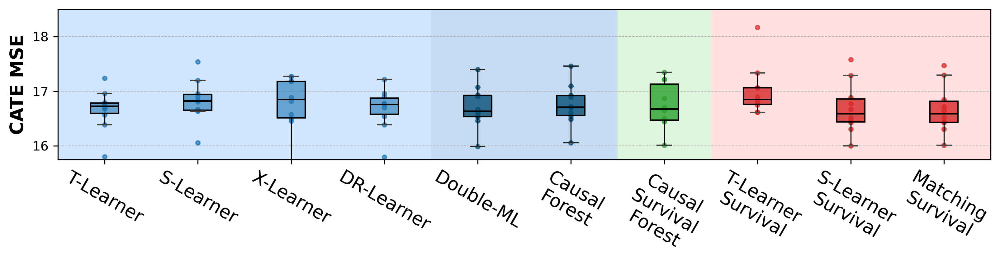

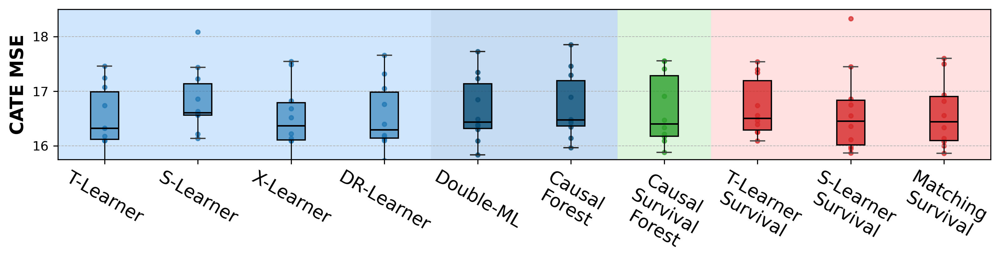

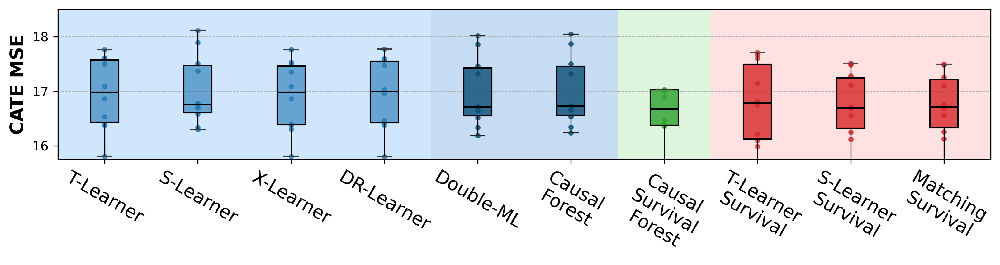

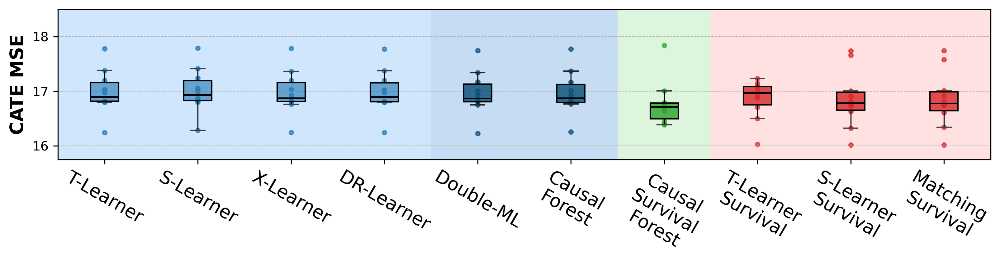

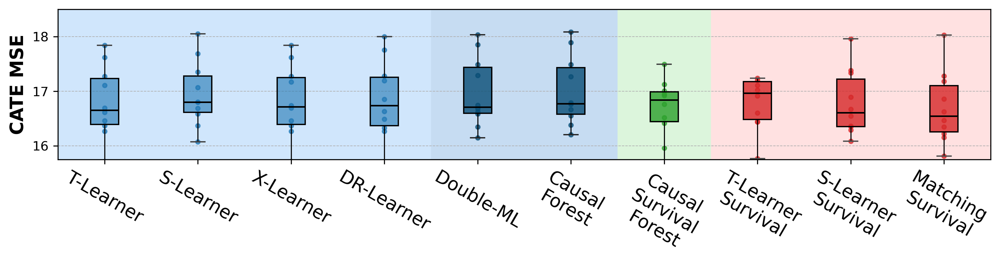

In [24]:
# Set the scenario key
scenario_key = "scenario_8"

# skip_experiments_list = ["RCT_0_5", "RCT_0_05"]
# metric = "cate_mse"  # Choose from ['cate_mse', 'ate_true', 'ate_pred', 'ate_bias']
# y_lim = None # Set to False to use individual y-limits for each plot or None for global limits
print(f"Scenario: {scenario_key}")

y_lim = Y_LIM.get(metric, {}).get(scenario_key, None)
# y_lim = (15.75, 18.75)

plot_aggregated_experiment_results(scenario_key, best_model_for_each_exp_setting, skip_experiments_list, metric=metric, y_lim=y_lim, title_include_scenario=False)

In [25]:
# Set the scenario key
# scenario_key = "scenario_8"
# skip_experiments_list = ["RCT_0_5", "RCT_0_05"]

best_model_for_each_exp_setting

print(f"Scenario: {scenario_key}")
pretty_results_table(best_model_for_each_exp_setting[best_model_for_each_exp_setting['scenario']==scenario_key])

Scenario: scenario_8


,experiment_id,experiment,method,best_imputation,best_base_model,best_base_survival,cate_mse,ate_bias
30,RCT_0_05,"RCT: ✓ (5%), Ignorability: ✓, Positivity: ✓, I...",Causal Forest,Margin,,,16.880 ± 0.563,-0.536 ± 0.078
31,RCT_0_05,"RCT: ✓ (5%), Ignorability: ✓, Positivity: ✓, I...",Causal Survival Forest,,,,16.882 ± 0.728,-0.436 ± 0.283
32,RCT_0_05,"RCT: ✓ (5%), Ignorability: ✓, Positivity: ✓, I...",Double-ML,Margin,,,16.785 ± 0.563,-0.537 ± 0.077
33,RCT_0_05,"RCT: ✓ (5%), Ignorability: ✓, Positivity: ✓, I...",DR-Learner,Margin,lasso,,16.787 ± 0.559,-0.522 ± 0.081
34,RCT_0_05,"RCT: ✓ (5%), Ignorability: ✓, Positivity: ✓, I...",Matching Survival,,,DeepSurv,16.873 ± 0.798,-0.149 ± 0.322
...,...,...,...,...,...,...,...,...
385,e_X_no_overlap_info_censor,"RCT: ✗, Ignorability: ✓, Positivity: ✗, Ignora...",S-Learner,Margin,rf,,16.945 ± 0.573,-0.667 ± 0.077
386,e_X_no_overlap_info_censor,"RCT: ✗, Ignorability: ✓, Positivity: ✗, Ignora...",S-Learner Survival,,,RandomSurvivalForest,16.784 ± 0.567,-0.344 ± 0.219
387,e_X_no_overlap_info_censor,"RCT: ✗, Ignorability: ✓, Positivity: ✗, Ignora...",T-Learner,Pseudo_obs,lasso,,16.793 ± 0.622,-0.476 ± 0.266
388,e_X_no_overlap_info_censor,"RCT: ✗, Ignorability: ✓, Positivity: ✗, Ignora...",T-Learner Survival,,,DeepSurv,16.927 ± 0.696,-0.119 ± 0.245


## Scenario 9

Scenario: scenario_9


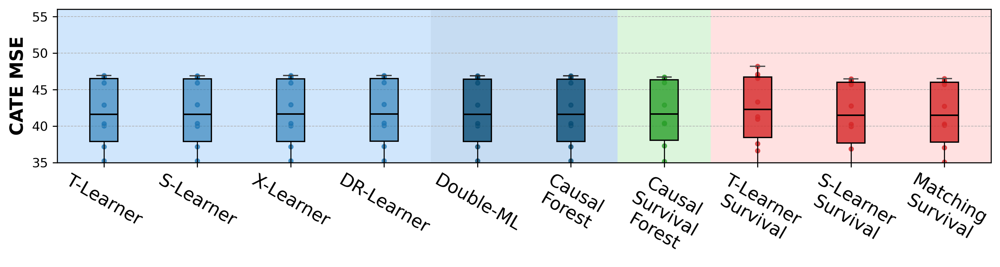

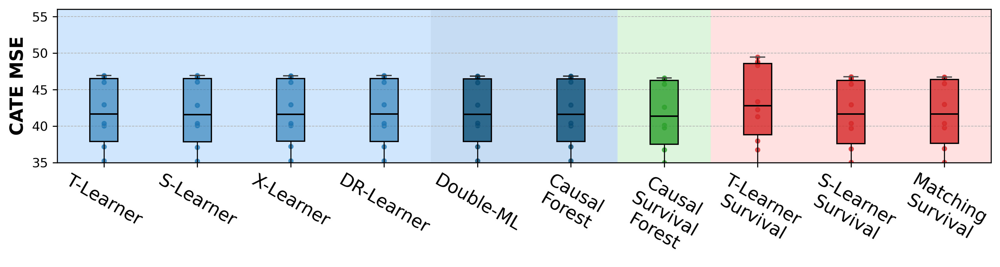

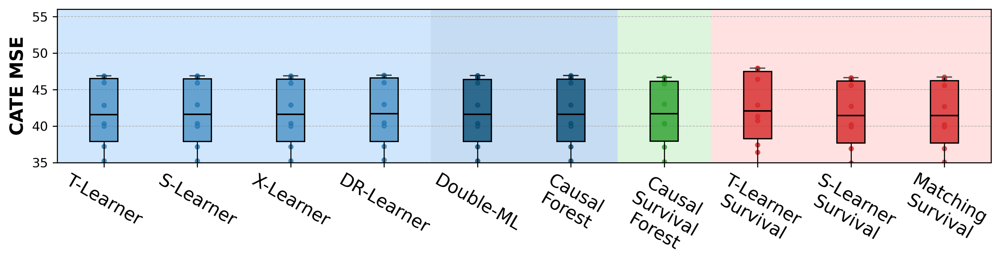

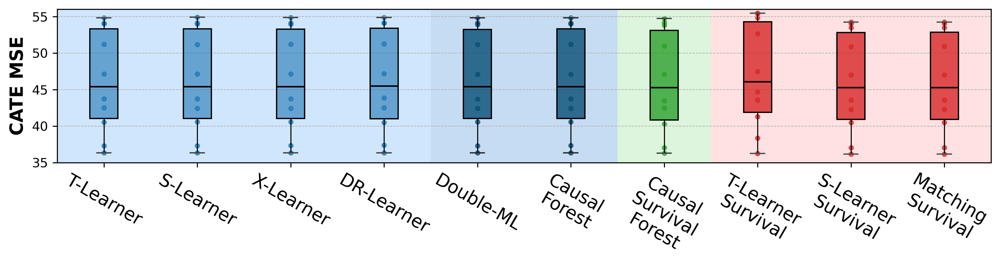

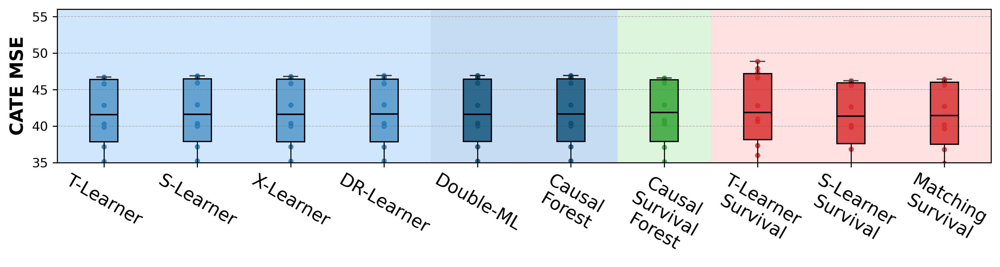

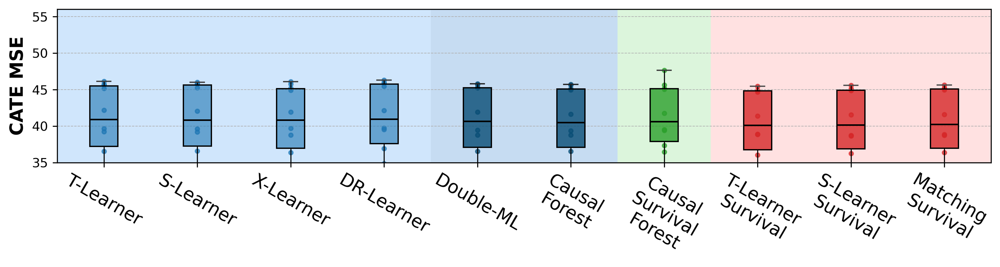

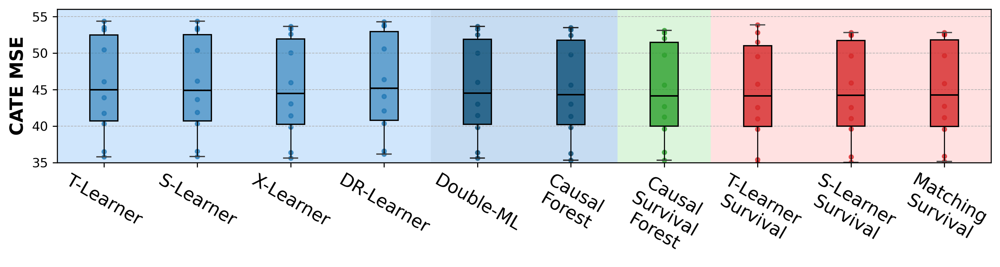

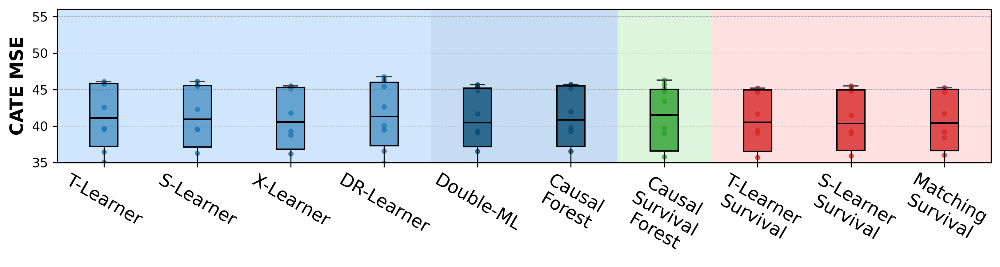

In [26]:
# Set the scenario key
scenario_key = "scenario_9"

# skip_experiments_list = ["RCT_0_5", "RCT_0_05"]
# metric = "cate_mse"  # Choose from ['cate_mse', 'ate_true', 'ate_pred', 'ate_bias']
# y_lim = None # Set to False to use i
# ndividual y-limits for each plot or None for global limits
# y_lim = (35, 56)
y_lim = Y_LIM.get(metric, {}).get(scenario_key, None)

print(f"Scenario: {scenario_key}")

plot_aggregated_experiment_results(scenario_key, best_model_for_each_exp_setting, skip_experiments_list, metric=metric, y_lim=y_lim, title_include_scenario=False)

In [27]:
# Set the scenario key
# scenario_key = "scenario_9"
# skip_experiments_list = ["RCT_0_5", "RCT_0_05"]

best_model_for_each_exp_setting

print(f"Scenario: {scenario_key}")
pretty_results_table(best_model_for_each_exp_setting[best_model_for_each_exp_setting['scenario']==scenario_key])

Scenario: scenario_9


,experiment_id,experiment,method,best_imputation,best_base_model,best_base_survival,cate_mse,ate_bias
40,RCT_0_05,"RCT: ✓ (5%), Ignorability: ✓, Positivity: ✓, I...",Causal Forest,Margin,,,41.392 ± 5.073,-0.736 ± 0.018
41,RCT_0_05,"RCT: ✓ (5%), Ignorability: ✓, Positivity: ✓, I...",Causal Survival Forest,,,,41.089 ± 5.091,-0.530 ± 0.067
42,RCT_0_05,"RCT: ✓ (5%), Ignorability: ✓, Positivity: ✓, I...",Double-ML,Margin,,,41.388 ± 5.075,-0.736 ± 0.016
43,RCT_0_05,"RCT: ✓ (5%), Ignorability: ✓, Positivity: ✓, I...",DR-Learner,Margin,lasso,,41.408 ± 5.091,-0.739 ± 0.017
44,RCT_0_05,"RCT: ✓ (5%), Ignorability: ✓, Positivity: ✓, I...",Matching Survival,,,DeepSurv,41.266 ± 5.083,-0.614 ± 0.091
...,...,...,...,...,...,...,...,...
395,e_X_no_overlap_info_censor,"RCT: ✗, Ignorability: ✓, Positivity: ✗, Ignora...",S-Learner,Margin,xgb,,40.669 ± 5.065,-0.672 ± 0.074
396,e_X_no_overlap_info_censor,"RCT: ✗, Ignorability: ✓, Positivity: ✗, Ignora...",S-Learner Survival,,,RandomSurvivalForest,40.118 ± 4.955,-0.519 ± 0.047
397,e_X_no_overlap_info_censor,"RCT: ✗, Ignorability: ✓, Positivity: ✗, Ignora...",T-Learner,Margin,rf,,40.852 ± 4.998,-0.691 ± 0.078
398,e_X_no_overlap_info_censor,"RCT: ✗, Ignorability: ✓, Positivity: ✗, Ignora...",T-Learner Survival,,,RandomSurvivalForest,40.023 ± 4.980,-0.409 ± 0.186


# ATE Bias

In [28]:
skip_experiments_list = [] #['RCT_0_5', 'RCT_0_05']
metric = "ate_bias"  # Choose from ['cate_mse', 'ate_true', 'ate_pred', 'ate_bias']

## Scenario 1

Scenario: scenario_1


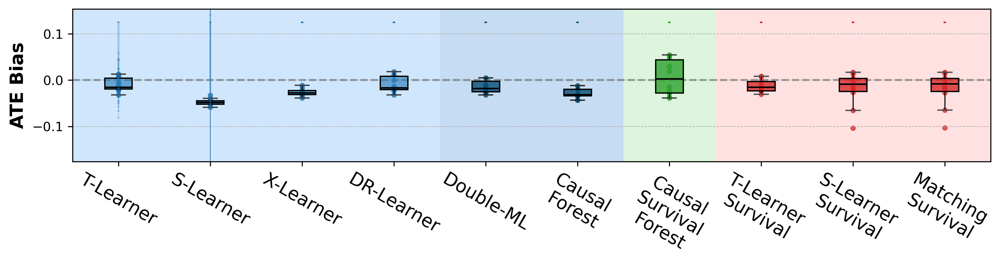

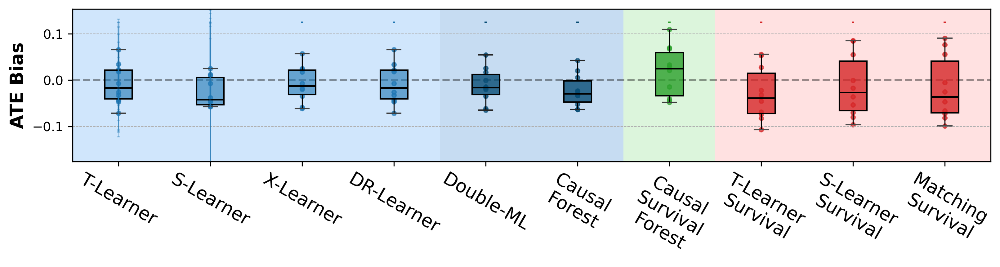

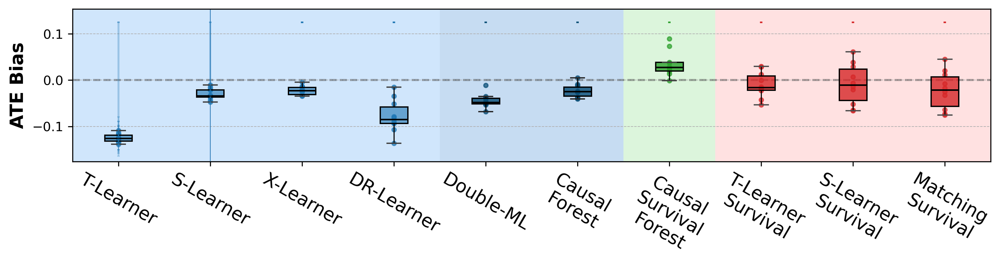

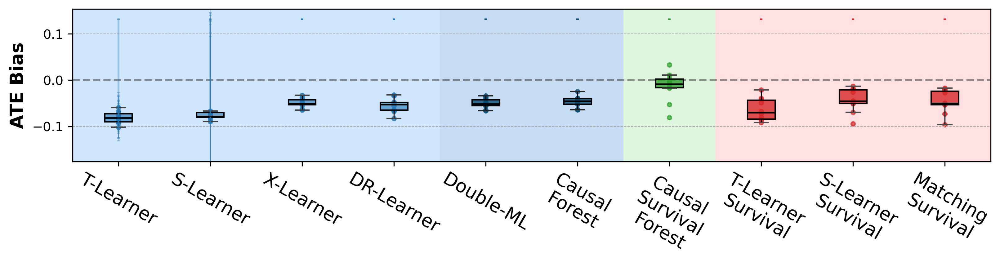

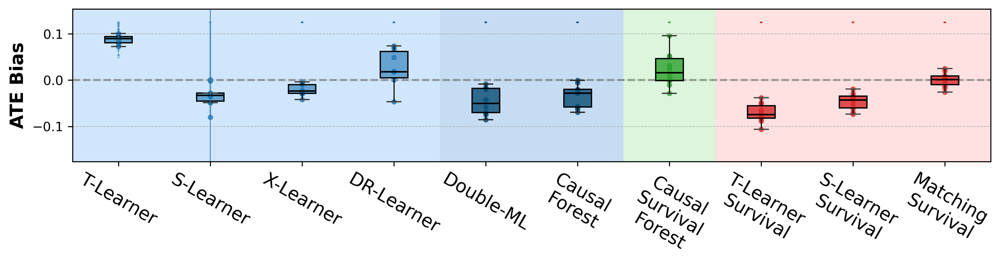

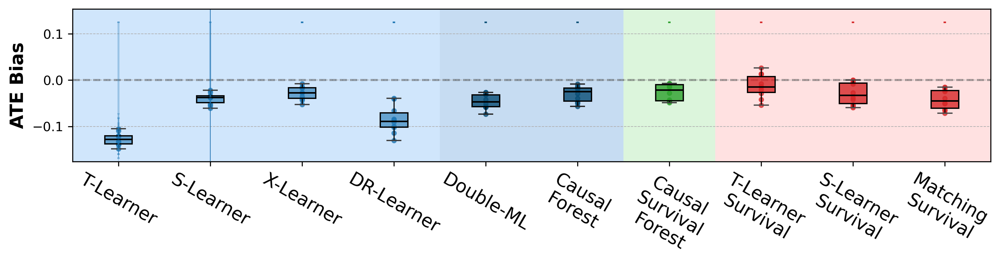

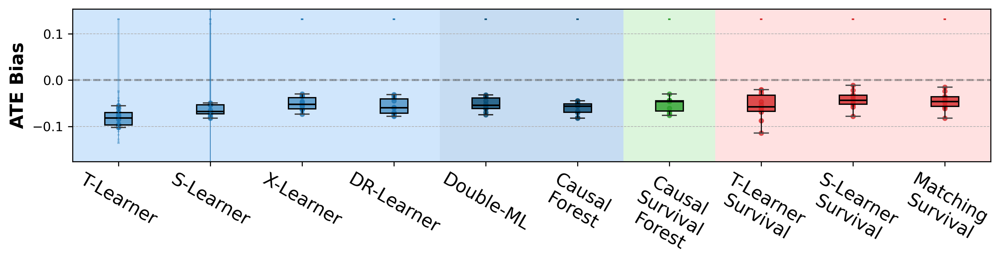

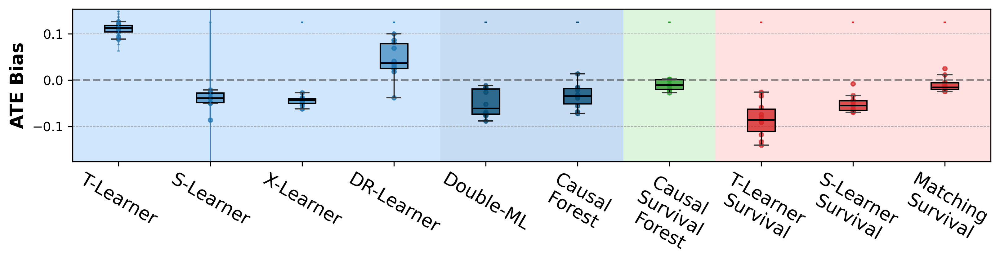

In [56]:
# Set the scenario key
scenario_key = "scenario_1"

# skip_experiments_list = ["RCT_0_5", "RCT_0_05"]
# metric = "cate_mse"  # Choose from ['cate_mse', 'ate_true', 'ate_pred', 'ate_bias']
# y_lim = None # Set to False to use individual y-limits for each plot or None for global limits
print(f"Scenario: {scenario_key}")

y_lim = Y_LIM.get(metric, {}).get(scenario_key, None)

plot_aggregated_experiment_results(scenario_key, best_model_for_each_exp_setting, skip_experiments_list, metric=metric, y_lim=y_lim, title_include_scenario=False)

In [30]:
# Set the scenario key
# scenario_key = "scenario_1"
# skip_experiments_list = ["RCT_0_5", "RCT_0_05"]

best_model_for_each_exp_setting

print(f"Scenario: {scenario_key}")
pretty_results_table(best_model_for_each_exp_setting[best_model_for_each_exp_setting['scenario']==scenario_key])

Scenario: scenario_1


,experiment_id,experiment,method,best_imputation,best_base_model,best_base_survival,cate_mse,ate_bias
0,RCT_0_05,"RCT: ✓ (5%), Ignorability: ✓, Positivity: ✓, I...",Causal Forest,IPCW-T,,,0.662 ± 0.068,-0.023 ± 0.034
1,RCT_0_05,"RCT: ✓ (5%), Ignorability: ✓, Positivity: ✓, I...",Causal Survival Forest,,,,0.652 ± 0.070,0.018 ± 0.052
2,RCT_0_05,"RCT: ✓ (5%), Ignorability: ✓, Positivity: ✓, I...",Double-ML,Margin,,,0.652 ± 0.070,-0.012 ± 0.036
3,RCT_0_05,"RCT: ✓ (5%), Ignorability: ✓, Positivity: ✓, I...",DR-Learner,Margin,lasso,,0.658 ± 0.073,-0.009 ± 0.041
4,RCT_0_05,"RCT: ✓ (5%), Ignorability: ✓, Positivity: ✓, I...",Matching Survival,,,DeepSurv,0.662 ± 0.075,-0.017 ± 0.066
...,...,...,...,...,...,...,...,...
355,e_X_no_overlap_info_censor,"RCT: ✗, Ignorability: ✓, Positivity: ✗, Ignora...",S-Learner,Margin,xgb,,0.666 ± 0.068,-0.041 ± 0.018
356,e_X_no_overlap_info_censor,"RCT: ✗, Ignorability: ✓, Positivity: ✗, Ignora...",S-Learner Survival,,,DeepSurv,0.654 ± 0.076,-0.051 ± 0.018
357,e_X_no_overlap_info_censor,"RCT: ✗, Ignorability: ✓, Positivity: ✗, Ignora...",T-Learner,IPCW-T,lasso,,0.668 ± 0.071,0.110 ± 0.012
358,e_X_no_overlap_info_censor,"RCT: ✗, Ignorability: ✓, Positivity: ✗, Ignora...",T-Learner Survival,,,DeepSurv,0.675 ± 0.073,-0.085 ± 0.037


## Scenario 2

Scenario: scenario_2


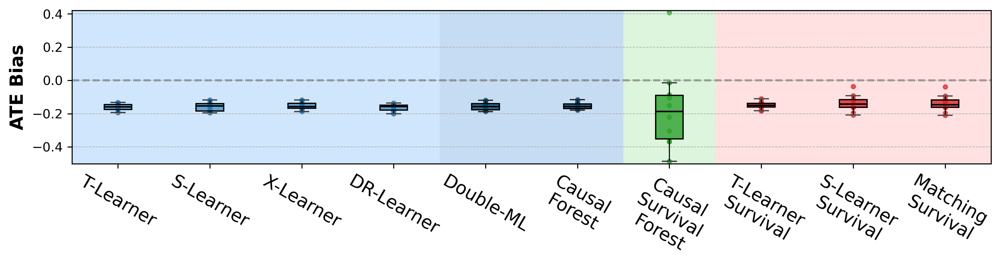

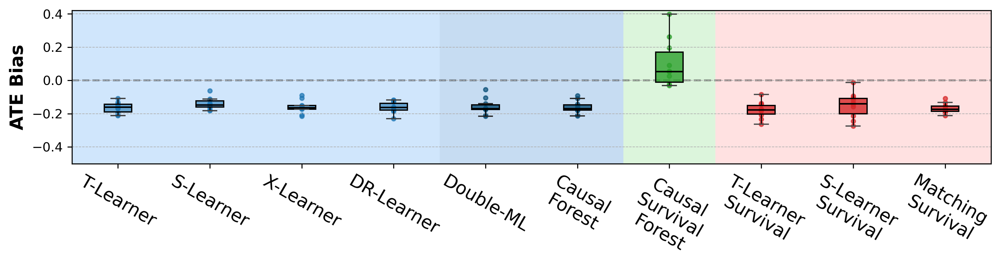

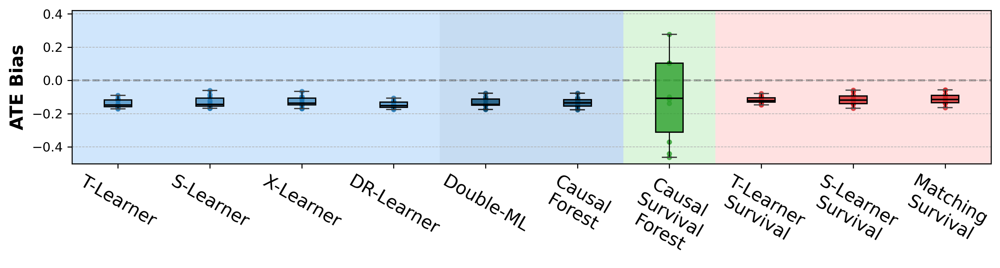

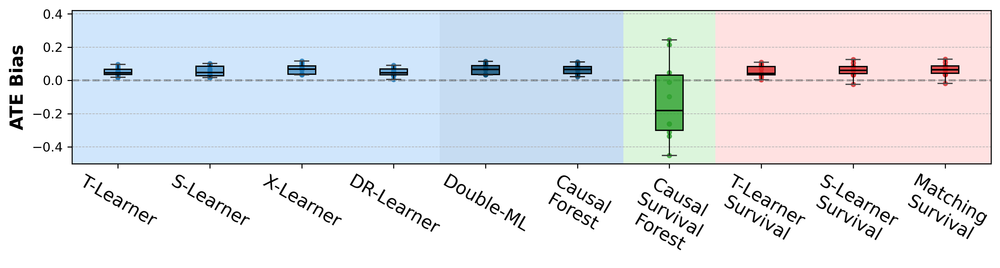

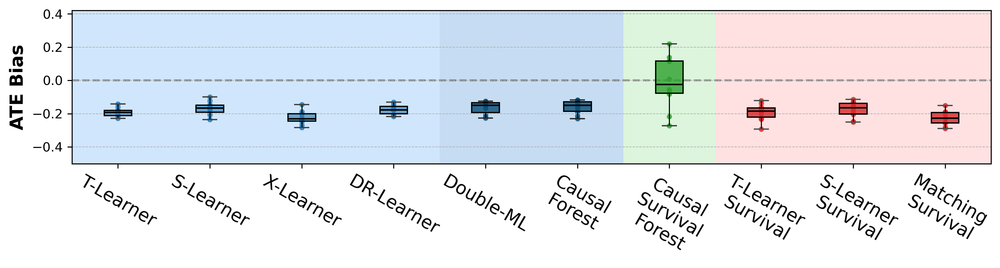

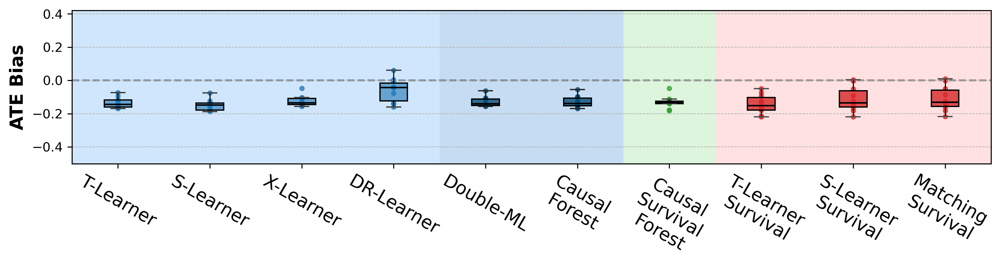

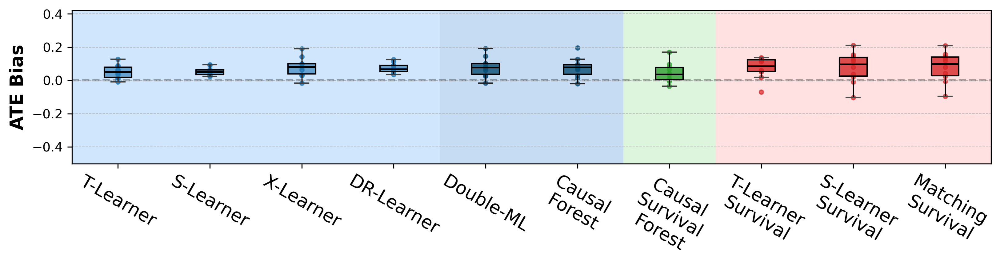

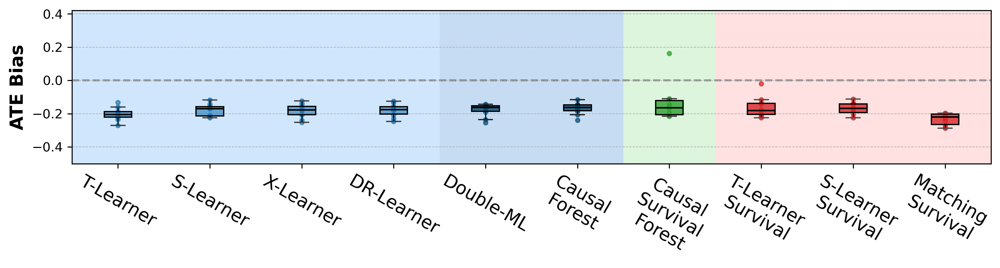

In [31]:
# Set the scenario key
scenario_key = "scenario_2"

# skip_experiments_list = ["RCT_0_5", "RCT_0_05"]
# metric = "cate_mse"  # Choose from ['cate_mse', 'ate_true', 'ate_pred', 'ate_bias']
# y_lim = None # Set to False to use individual y-limits for each plot or None for global limits
print(f"Scenario: {scenario_key}")

# y_lim = (10, 18.5)
y_lim = Y_LIM.get(metric, {}).get(scenario_key, None)

plot_aggregated_experiment_results(scenario_key, best_model_for_each_exp_setting, skip_experiments_list, metric=metric, y_lim=y_lim, title_include_scenario=False)

In [32]:
# Set the scenario key
# scenario_key = "scenario_2"
# skip_experiments_list = ["RCT_0_5", "RCT_0_05"]

best_model_for_each_exp_setting

print(f"Scenario: {scenario_key}")
pretty_results_table(best_model_for_each_exp_setting[best_model_for_each_exp_setting['scenario']==scenario_key])

Scenario: scenario_2


,experiment_id,experiment,method,best_imputation,best_base_model,best_base_survival,cate_mse,ate_bias
10,RCT_0_05,"RCT: ✓ (5%), Ignorability: ✓, Positivity: ✓, I...",Causal Forest,Margin,,,12.275 ± 1.906,-0.161 ± 0.037
11,RCT_0_05,"RCT: ✓ (5%), Ignorability: ✓, Positivity: ✓, I...",Causal Survival Forest,,,,12.662 ± 2.352,-0.038 ± 0.475
12,RCT_0_05,"RCT: ✓ (5%), Ignorability: ✓, Positivity: ✓, I...",Double-ML,Pseudo_obs,,,12.162 ± 1.886,-0.157 ± 0.045
13,RCT_0_05,"RCT: ✓ (5%), Ignorability: ✓, Positivity: ✓, I...",DR-Learner,IPCW-T,lasso,,12.327 ± 1.919,-0.163 ± 0.033
14,RCT_0_05,"RCT: ✓ (5%), Ignorability: ✓, Positivity: ✓, I...",Matching Survival,,,RandomSurvivalForest,12.300 ± 1.908,-0.167 ± 0.029
...,...,...,...,...,...,...,...,...
365,e_X_no_overlap_info_censor,"RCT: ✗, Ignorability: ✓, Positivity: ✗, Ignora...",S-Learner,IPCW-T,xgb,,12.274 ± 1.918,-0.178 ± 0.034
366,e_X_no_overlap_info_censor,"RCT: ✗, Ignorability: ✓, Positivity: ✗, Ignora...",S-Learner Survival,,,DeepSurv,12.160 ± 1.883,-0.168 ± 0.033
367,e_X_no_overlap_info_censor,"RCT: ✗, Ignorability: ✓, Positivity: ✗, Ignora...",T-Learner,IPCW-T,rf,,12.287 ± 1.903,-0.202 ± 0.037
368,e_X_no_overlap_info_censor,"RCT: ✗, Ignorability: ✓, Positivity: ✗, Ignora...",T-Learner Survival,,,DeepSurv,12.161 ± 1.868,-0.161 ± 0.058


## Scenario 5

Scenario: scenario_5


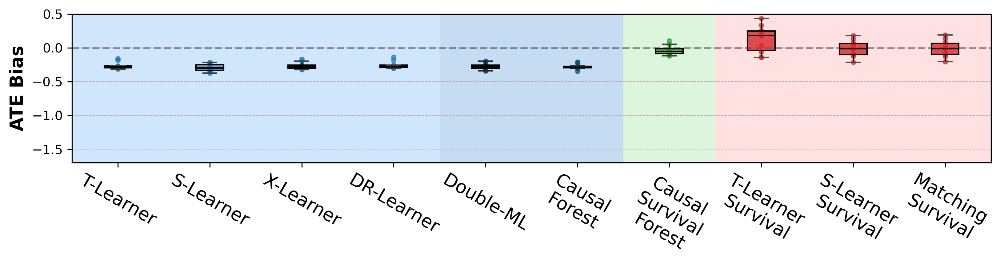

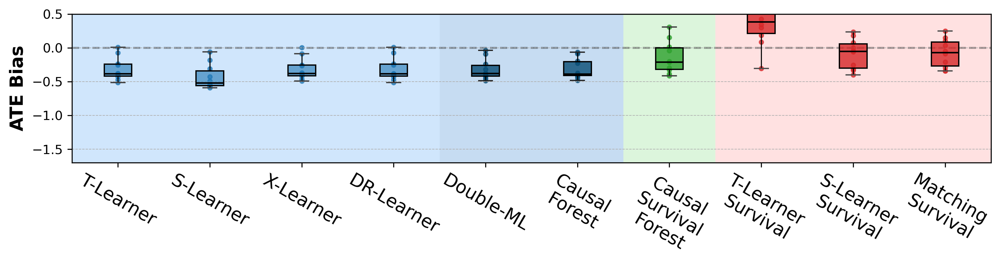

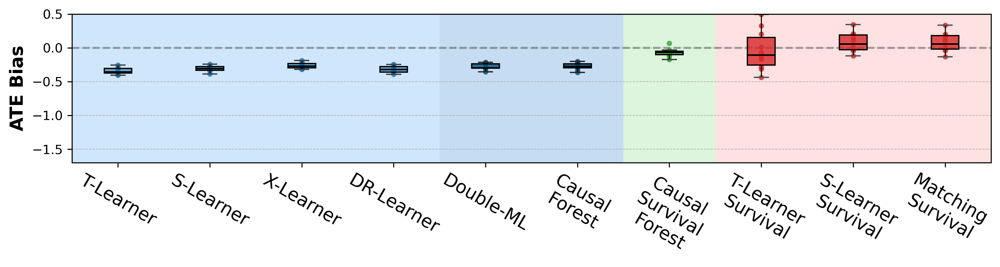

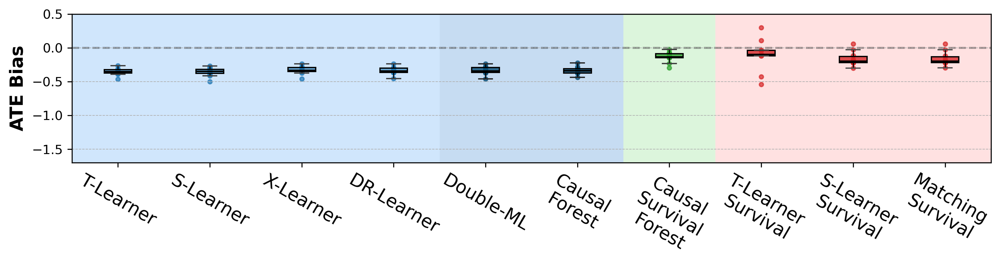

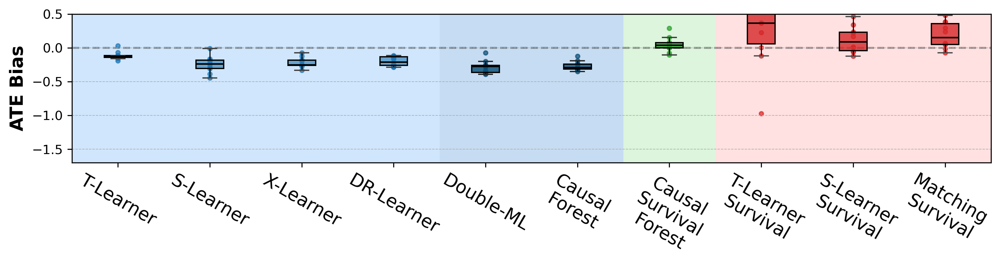

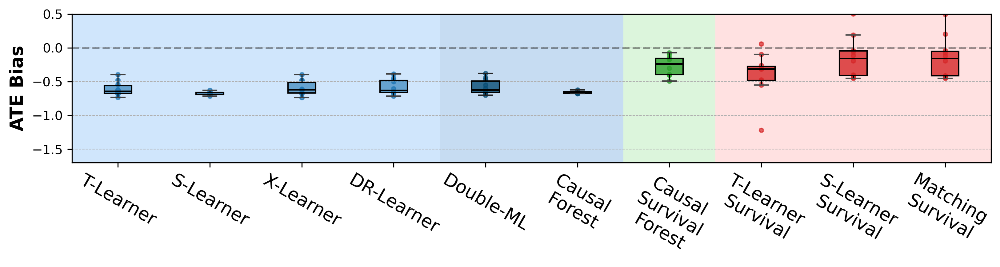

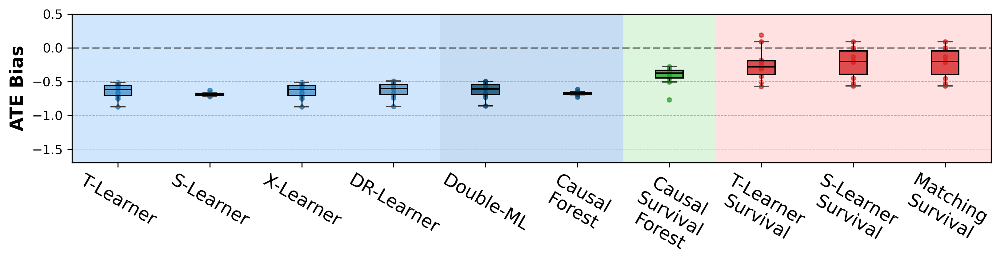

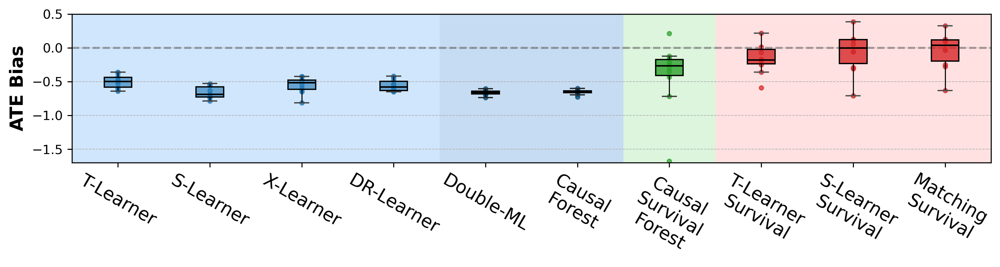

In [33]:
# Set the scenario key
scenario_key = "scenario_5"

# skip_experiments_list = ["RCT_0_5", "RCT_0_05"]
# metric = "cate_mse"  # Choose from ['cate_mse', 'ate_true', 'ate_pred', 'ate_bias']
# y_lim = None # Set to False to use individual y-limits for each plot or None for global limits
print(f"Scenario: {scenario_key}")

y_lim = Y_LIM.get(metric, {}).get(scenario_key, None)
# y_lim = (13.75, 16.25)

plot_aggregated_experiment_results(scenario_key, best_model_for_each_exp_setting, skip_experiments_list, metric=metric, y_lim=y_lim, title_include_scenario=False)

In [34]:
# Set the scenario key
# scenario_key = "scenario_5"
# skip_experiments_list = ["RCT_0_5", "RCT_0_05"]

best_model_for_each_exp_setting

print(f"Scenario: {scenario_key}")
pretty_results_table(best_model_for_each_exp_setting[best_model_for_each_exp_setting['scenario']==scenario_key])

Scenario: scenario_5


,experiment_id,experiment,method,best_imputation,best_base_model,best_base_survival,cate_mse,ate_bias
20,RCT_0_05,"RCT: ✓ (5%), Ignorability: ✓, Positivity: ✓, I...",Causal Forest,IPCW-T,,,14.983 ± 0.420,-0.310 ± 0.144
21,RCT_0_05,"RCT: ✓ (5%), Ignorability: ✓, Positivity: ✓, I...",Causal Survival Forest,,,,14.743 ± 0.457,-0.143 ± 0.229
22,RCT_0_05,"RCT: ✓ (5%), Ignorability: ✓, Positivity: ✓, I...",Double-ML,IPCW-T,,,14.795 ± 0.423,-0.323 ± 0.144
23,RCT_0_05,"RCT: ✓ (5%), Ignorability: ✓, Positivity: ✓, I...",DR-Learner,IPCW-T,lasso,,14.893 ± 0.446,-0.315 ± 0.163
24,RCT_0_05,"RCT: ✓ (5%), Ignorability: ✓, Positivity: ✓, I...",Matching Survival,,,DeepSurv,14.852 ± 0.389,-0.080 ± 0.202
...,...,...,...,...,...,...,...,...
375,e_X_no_overlap_info_censor,"RCT: ✗, Ignorability: ✓, Positivity: ✗, Ignora...",S-Learner,Margin,rf,,15.239 ± 0.459,-0.663 ± 0.086
376,e_X_no_overlap_info_censor,"RCT: ✗, Ignorability: ✓, Positivity: ✗, Ignora...",S-Learner Survival,,,DeepSurv,15.027 ± 0.511,0.007 ± 0.396
377,e_X_no_overlap_info_censor,"RCT: ✗, Ignorability: ✓, Positivity: ✗, Ignora...",T-Learner,Pseudo_obs,lasso,,15.039 ± 0.508,-0.504 ± 0.093
378,e_X_no_overlap_info_censor,"RCT: ✗, Ignorability: ✓, Positivity: ✗, Ignora...",T-Learner Survival,,,DeepHit,15.082 ± 0.512,-0.162 ± 0.210


## Scenario 8

Scenario: scenario_8


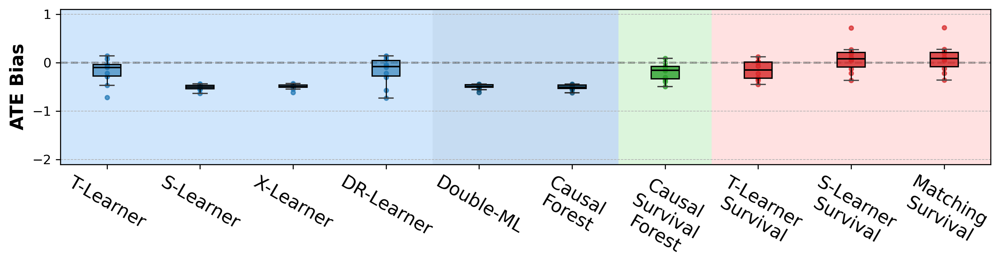

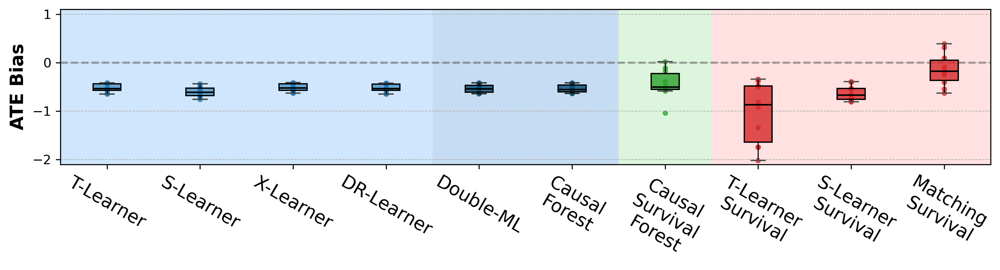

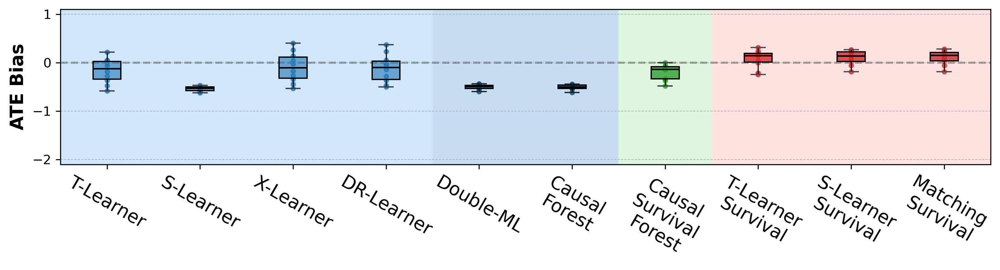

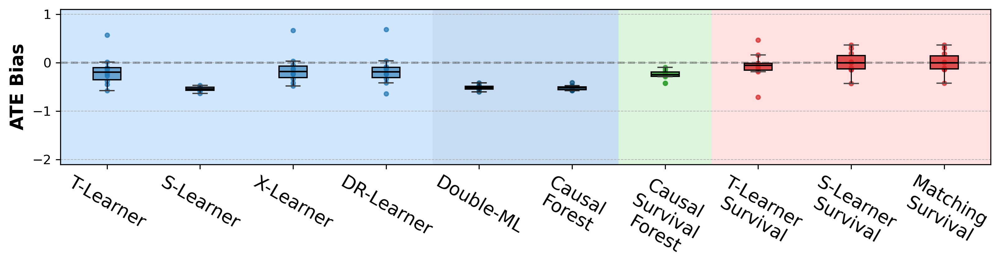

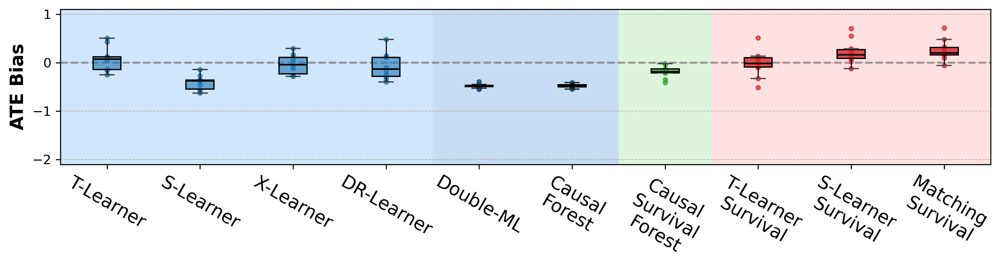

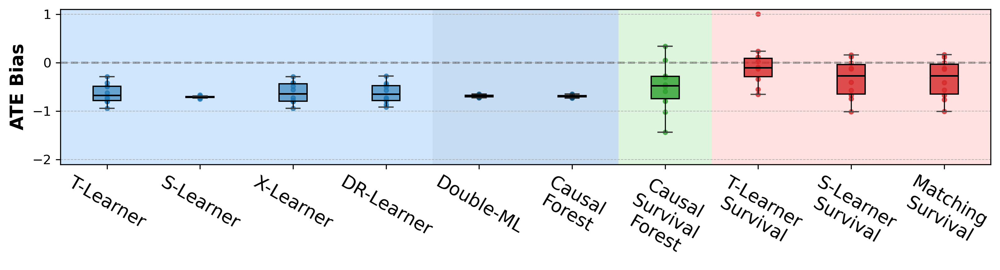

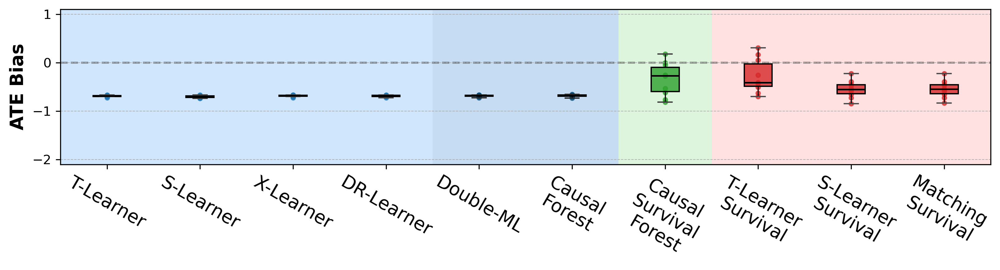

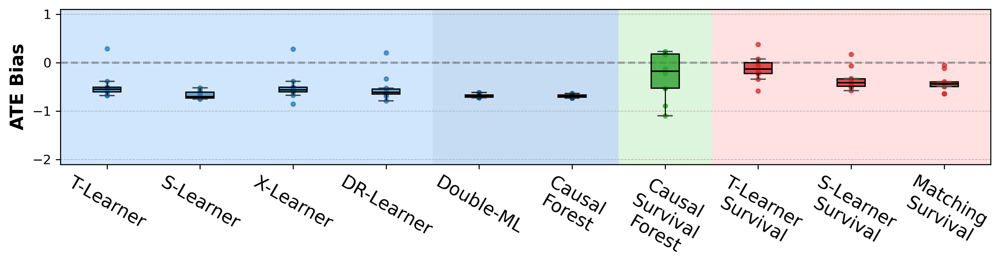

In [35]:
# Set the scenario key
scenario_key = "scenario_8"

# skip_experiments_list = ["RCT_0_5", "RCT_0_05"]
# metric = "cate_mse"  # Choose from ['cate_mse', 'ate_true', 'ate_pred', 'ate_bias']
# y_lim = None # Set to False to use individual y-limits for each plot or None for global limits
print(f"Scenario: {scenario_key}")

y_lim = Y_LIM.get(metric, {}).get(scenario_key, None)
# y_lim = (15.75, 18.75)

plot_aggregated_experiment_results(scenario_key, best_model_for_each_exp_setting, skip_experiments_list, metric=metric, y_lim=y_lim, title_include_scenario=False)

In [36]:
# Set the scenario key
# scenario_key = "scenario_8"
# skip_experiments_list = ["RCT_0_5", "RCT_0_05"]

best_model_for_each_exp_setting

print(f"Scenario: {scenario_key}")
pretty_results_table(best_model_for_each_exp_setting[best_model_for_each_exp_setting['scenario']==scenario_key])

Scenario: scenario_8


,experiment_id,experiment,method,best_imputation,best_base_model,best_base_survival,cate_mse,ate_bias
30,RCT_0_05,"RCT: ✓ (5%), Ignorability: ✓, Positivity: ✓, I...",Causal Forest,Margin,,,16.880 ± 0.563,-0.536 ± 0.078
31,RCT_0_05,"RCT: ✓ (5%), Ignorability: ✓, Positivity: ✓, I...",Causal Survival Forest,,,,16.882 ± 0.728,-0.436 ± 0.283
32,RCT_0_05,"RCT: ✓ (5%), Ignorability: ✓, Positivity: ✓, I...",Double-ML,Margin,,,16.785 ± 0.563,-0.537 ± 0.077
33,RCT_0_05,"RCT: ✓ (5%), Ignorability: ✓, Positivity: ✓, I...",DR-Learner,Margin,lasso,,16.787 ± 0.559,-0.522 ± 0.081
34,RCT_0_05,"RCT: ✓ (5%), Ignorability: ✓, Positivity: ✓, I...",Matching Survival,,,DeepSurv,16.873 ± 0.798,-0.149 ± 0.322
...,...,...,...,...,...,...,...,...
385,e_X_no_overlap_info_censor,"RCT: ✗, Ignorability: ✓, Positivity: ✗, Ignora...",S-Learner,Margin,rf,,16.945 ± 0.573,-0.667 ± 0.077
386,e_X_no_overlap_info_censor,"RCT: ✗, Ignorability: ✓, Positivity: ✗, Ignora...",S-Learner Survival,,,RandomSurvivalForest,16.784 ± 0.567,-0.344 ± 0.219
387,e_X_no_overlap_info_censor,"RCT: ✗, Ignorability: ✓, Positivity: ✗, Ignora...",T-Learner,Pseudo_obs,lasso,,16.793 ± 0.622,-0.476 ± 0.266
388,e_X_no_overlap_info_censor,"RCT: ✗, Ignorability: ✓, Positivity: ✗, Ignora...",T-Learner Survival,,,DeepSurv,16.927 ± 0.696,-0.119 ± 0.245


## Scenario 9

Scenario: scenario_9


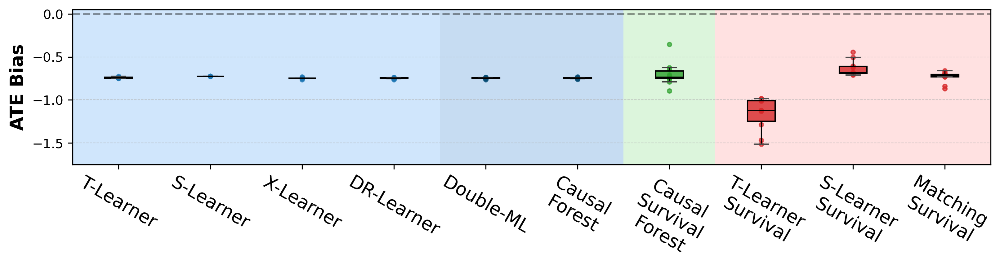

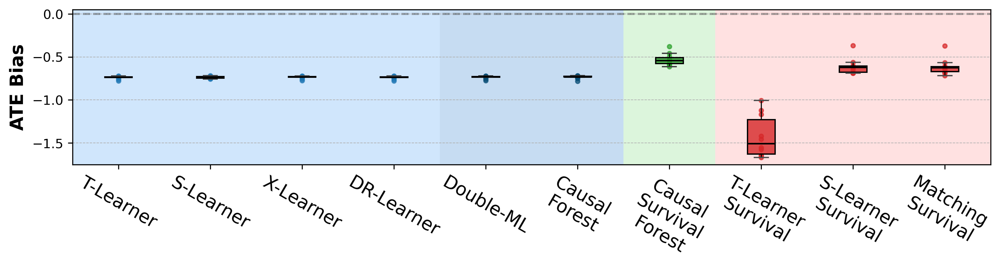

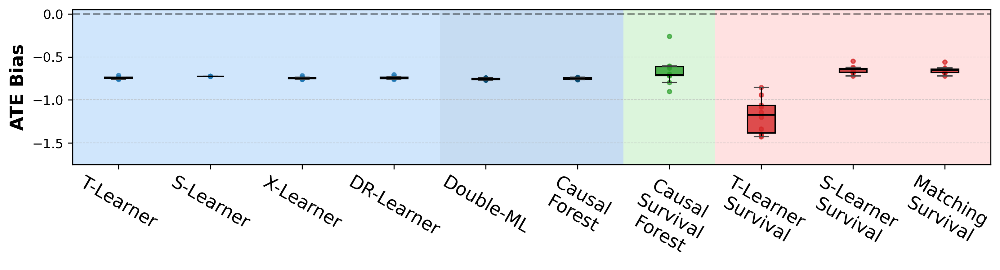

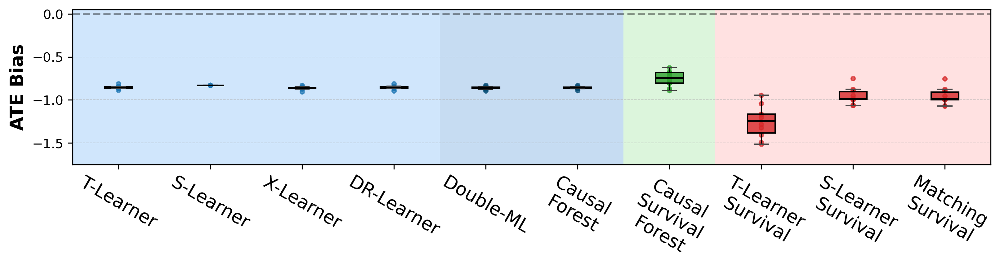

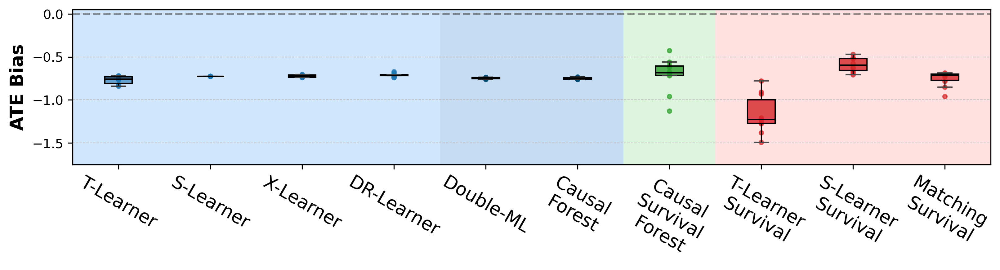

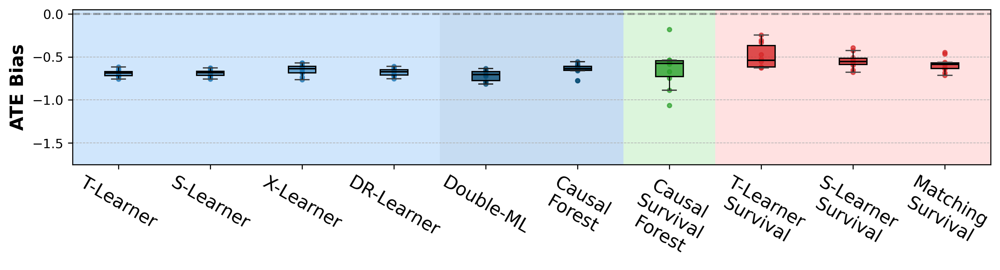

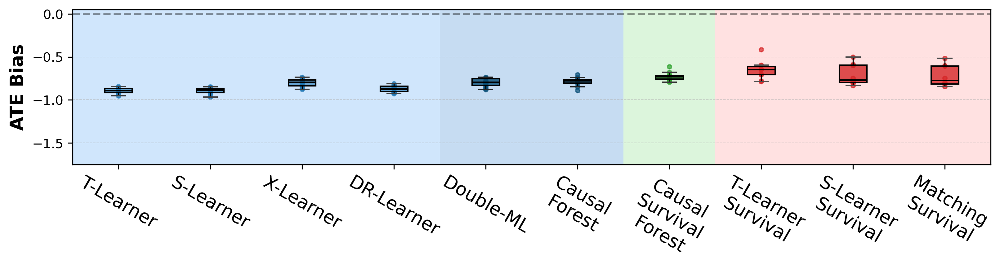

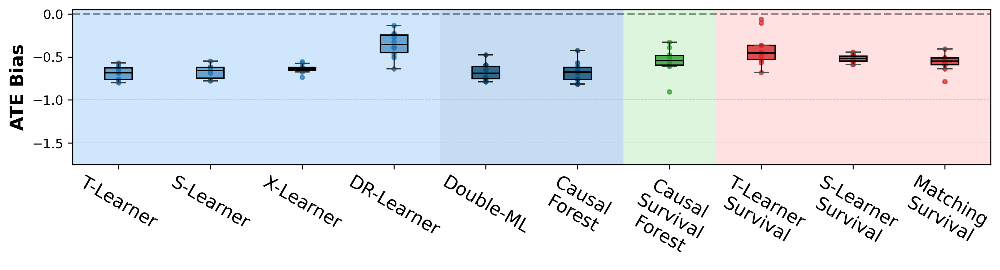

In [37]:
# Set the scenario key
scenario_key = "scenario_9"

# skip_experiments_list = ["RCT_0_5", "RCT_0_05"]
# metric = "cate_mse"  # Choose from ['cate_mse', 'ate_true', 'ate_pred', 'ate_bias']
# y_lim = None # Set to False to use i
# ndividual y-limits for each plot or None for global limits
# y_lim = (35, 56)
y_lim = Y_LIM.get(metric, {}).get(scenario_key, None)

print(f"Scenario: {scenario_key}")

plot_aggregated_experiment_results(scenario_key, best_model_for_each_exp_setting, skip_experiments_list, metric=metric, y_lim=y_lim, title_include_scenario=False)

In [38]:
# Set the scenario key
# scenario_key = "scenario_9"
# skip_experiments_list = ["RCT_0_5", "RCT_0_05"]

best_model_for_each_exp_setting

print(f"Scenario: {scenario_key}")
pretty_results_table(best_model_for_each_exp_setting[best_model_for_each_exp_setting['scenario']==scenario_key])

Scenario: scenario_9


,experiment_id,experiment,method,best_imputation,best_base_model,best_base_survival,cate_mse,ate_bias
40,RCT_0_05,"RCT: ✓ (5%), Ignorability: ✓, Positivity: ✓, I...",Causal Forest,Margin,,,41.392 ± 5.073,-0.736 ± 0.018
41,RCT_0_05,"RCT: ✓ (5%), Ignorability: ✓, Positivity: ✓, I...",Causal Survival Forest,,,,41.089 ± 5.091,-0.530 ± 0.067
42,RCT_0_05,"RCT: ✓ (5%), Ignorability: ✓, Positivity: ✓, I...",Double-ML,Margin,,,41.388 ± 5.075,-0.736 ± 0.016
43,RCT_0_05,"RCT: ✓ (5%), Ignorability: ✓, Positivity: ✓, I...",DR-Learner,Margin,lasso,,41.408 ± 5.091,-0.739 ± 0.017
44,RCT_0_05,"RCT: ✓ (5%), Ignorability: ✓, Positivity: ✓, I...",Matching Survival,,,DeepSurv,41.266 ± 5.083,-0.614 ± 0.091
...,...,...,...,...,...,...,...,...
395,e_X_no_overlap_info_censor,"RCT: ✗, Ignorability: ✓, Positivity: ✗, Ignora...",S-Learner,Margin,xgb,,40.669 ± 5.065,-0.672 ± 0.074
396,e_X_no_overlap_info_censor,"RCT: ✗, Ignorability: ✓, Positivity: ✗, Ignora...",S-Learner Survival,,,RandomSurvivalForest,40.118 ± 4.955,-0.519 ± 0.047
397,e_X_no_overlap_info_censor,"RCT: ✗, Ignorability: ✓, Positivity: ✗, Ignora...",T-Learner,Margin,rf,,40.852 ± 4.998,-0.691 ± 0.078
398,e_X_no_overlap_info_censor,"RCT: ✗, Ignorability: ✓, Positivity: ✗, Ignora...",T-Learner Survival,,,RandomSurvivalForest,40.023 ± 4.980,-0.409 ± 0.186
